In [28]:
# NECESSARY IMPORTS:

# GLOBAL IMPORTS:
from typing import Union
from glob import glob
import os 
os.environ["OMP_NUM_THREADS"] = '1'

# CLASSIC LIBRARIES:
import numpy as np
import matplotlib.pyplot as plt
import time

# LOAD IMAGES:
import PIL
from PIL import Image
from imageio import imsave

# SCIPY/IMAGE PROCESSING:
import cv2
from skimage.filters import gabor
from scipy.stats import skew, kurtosis
from skimage.filters import gabor_kernel
from scipy import ndimage as ndi
from skimage.util.shape import view_as_blocks

# SKLEARN:
# import VarianceThreshold from sklearn:
from sklearn.feature_selection import VarianceThreshold
from sklearn.decomposition import PCA

# KMEANS:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler

# import functions from functions.py:
from functions import show_image, show_example_images, load_input_image, save_solution_puzzles, apply_mat_morph, segment_image_canny, get_contours, save_tiles, get_hist_features, compute_gabor_feats
from functions import feature_selection, cluster, plot_clusters, get_puzzle, dimensionality_reduction
from save_evaluation_files import export_solutions

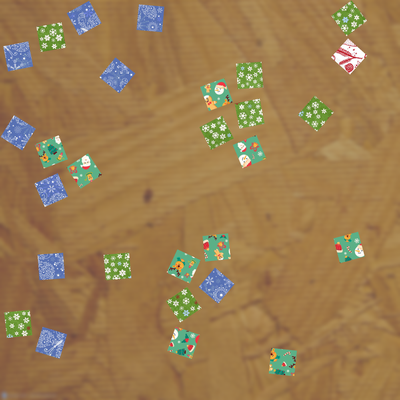

In [10]:
show_example_images()

---
## 0. Introduction

In this project, you will be working on solving tiling puzzles using image analysis and pattern recognition techniques. Tiling puzzles are a classic type of puzzle game that consists of fitting together pieces of a given shape (in this case squared to form a complete image. The goal of this project is to develop an algorithm that can automatically reconstruct tiling puzzles from a single input image. 

---

## 1. Data

### Input data
To achieve your task, you will be given images that look like this:

<img src="data_project/project_description/train_00.png" width="512"/>


### Example puzzle content
Example of input of solved puzzles. 
Solution 1
<img src="data_project/project_description/solution_example.png" width="512"/>
\\
Solution 2
<img src="data_project/project_description/solution_example2.jpg" width="512"/>


### 1.1. Image layout

- The input for the program will be a single image with a size of __2000x2000 pixels__, containing the pieces of the tiling puzzles randomly placed in it. The puzzles sizes vary from __3x3, 3x4, or 4x4__ size. 
    -__You are guaranteed to always have the exact number of pieces for each puzzle__ 
        -For each puzzle you always are expected to find exaclty 9,12,16 pieces
        -If you find something else, either you are missing pieces, or added incorrect pieces for the puzzle

- The puzzle pieces are square-shaped with dimensions of 128x128 pixels (before rotation). 

- The input image will contain pieces from __two or three (but never four)__ different tiling puzzles, as well as some __extra pieces (outliers)__ that do not belong to either puzzle.


## 2. Tasks (Total 20 points) 


The project aims to:
1) Segment the puzzle pieces from the background (recover the pieces of 128x128 pixels)   \[ __5 points__ \] 

2) Extract features of interest from puzzle pieces images \[ __5 points__ \]   

3) Cluster puzzle pieces to identify which puzzle they belong, and identify outliers.  \[ __5 points__ \]   

4) Solve tiling puzzle (find the rotations and translations to correctly allocate the puzzle pieces in a 3x3, 3x4 or 4x4 array.) \[ __5 points__ \]   

##### The images used for the puzzles have self-repeating patterns or textures, which ensures that all puzzle pieces contain more or less the same features regardless of how they were cut. 




### 1.2. Output solution pieces.

For each input image, the output solution will include N images with solved puzzles, where N is the number of puzzles in the input image and M images, and each of these images will contain the solved solution to one of the N puzzles in the input. 


-  Example input:  train_05.png

- Example solution:
        -solution_05_00.png solution_05_01.png solution_05_02.png 
        -outlier_05_00.png outlier_05_01.png outlier_05_02.png ...

- Example input:  train_07.png
- Example solution:
        -solution_07_00.png solution_07_01.png 
        -outlier_07_00.png outlier_07_01.png outlier_07_02.png ...


__Watch out!__ output resolution should always be like this:  
<table ><tr><th >Puzzle pieces <th><th> pixel dimentions <th> <th> pixel dimentions <th> <tr>
<tr><td> 3x3 <td><td> 384x384 <td><td> 3(128)x3(128) <td> <tr>
<tr><td> 3x4 <td><td> 384x512 <td><td> 3(128)x4(128)<tr>
<tr><td> 4x4 <td><td> 512x512 <td><td> 4(128)x4(128)<tr>
<tr><td> 1x1 (outlier)<td><td> 128x128 <td><td> (1)128x(1)128 <td><tr><table>





__Order of the solutions (and rotations) it's not a problem for the grading__




the output solution will be a final image of resolution (1283)x(1283), with each piece correctly placed in its corresponding location in the 3x3 array. Similarly, if the puzzle consists of 3x4 or 4x4 pieces, the output solution will be an image of resolution (1283)x(1284) or (1284)x(1284)



### 1.3 Data folder Structure

You can download the data for the project here: [download data](https://drive.google.com/drive/folders/1k3xTH0ZhpqZb3xcZ6wsOSjLzxBNYabg3?usp=share_link)

```
data_project
│
└─── project_description
│    │    example_input.png      # example input images
│    │    example_textures1.png      # example input images
│    │    example_textures2.png      # example input images
│    └─── ultimate_test.jpg   # If it works on that image, you would probably end up with a good score
│
└─── train
│    │    train_00.png        # Train image 00
│    │    ...
│    │    train_16.png        # Train image 16
│    └─── train_labels.csv    # Ground truth of the train set
|    
└────train_solution
│    │    solution_00_00.png        # Solution puzzle 1 from Train image 00
│    │    solution_00_01.png        # Solution puzzle 2 from Train image 00
│    │    solution_00_02.png        # Solution Puzzle 3 from Train image 00
│    │    outlier_00_00.png         # outlier     from Train image 00
│    │    outlier_00_01.png         # outlier     from Train image 00
│    │    outlier_00_03.png         # outlier     from Train image 00
│    │    ...
│    │    solution_15_00.png        # Solution puzzle 1 from Train image 15
│    │    solution_15_01.png        # Solution puzzle 2 from Train image 15
│    │    outlier_15_00.png         # outlier     from Train image 15
│    └─── outlier_15_01.png         # outlier     from Train image 15
│
└─── test
     │    test_00.png         # Test image 00 (day of the exam only)
     │    ...
     └─── test_xx.png             # Test image xx (day of the exam only)
```



## 3. Evaluation

**Before the exam**
   - Create a zipped folder named **groupid_xx.zip** that you upload on moodle (xx being your group number).
   - Include a **runnable** code (Jupyter Notebook and external files) and your presentation in the zip folder.
   
**The day of the exam**
   - You will be given a **new folder** (test folder) with few images, but **no ground truth** (no solutions).
   - We will ask you to run your pipeline in **real time** and to send us your prediction of the task you obtain with the provided function **save_results**. 
   - On our side, we will compute the performance of your classification algorithm. 
   - To evaluate your method, we will use the **evaluate_solution** function presented below. To understand how the provided functions work, please read the documentation of the functions in **utils.py**.
   - **Please make sure your function returns the proper data format to avoid points penalty on the day of the exam**. 
---


## 4. Your code

# 1. Segment the puzzle pieces from the background

### Load the input images, apply the Canny segmentation, apply morphological operators, get the tiles and plot the contours obtained 

##### Step 1 : Canny segmentation

The first function we use is the **segment_image_canny()** in functions.py.

We first normalized the image using the **cv2.normalize()** function, and filtered the image by a Gaussian blur (cv2.GaussianBlur()).

We apply the **cv2.Canny()** with the blurred image with 35 and 40 as a minimum and maximum threshold.

The cv2.Canny() algorithm consists of 5 steps: 

1. Noise reduction: smoothed image by Gaussian filter.

2. Gradient calculation: gradient magnitude represents strength of edge, direction is orientation of the edge.

3. Non-maximum suppression: keep only the local maxima in the gradient direction.

4. Thresholding: high and low thresholds are decided, we have chosen 35 and 40. 

5. Pixels with gradient magnitudes > high threshold = strong edges, pixels with gradient magnitudes < low threshold = non-edges and are discarded, pixels in between are weak edges.

7. Edge tracking by hysteresis: Links weak edges to strong edges. 


We chose low thresholds because the image already had a blurred background compared to the sharp tiles, hence yielded good results.


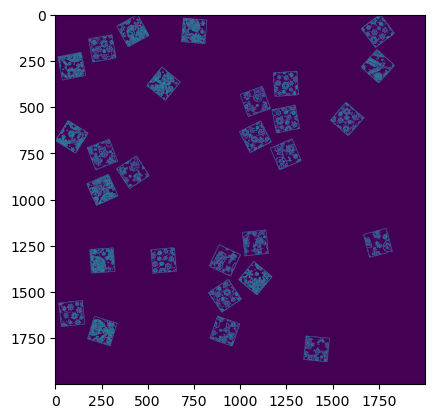

In [11]:
im = load_input_image(0)
md = segment_image_canny(im)
plt.imshow(md)

##### Step 2 : Mathematical morphology

We then used the **apply_mat_morph()** function that we wrote in functions.py

We are using here mathematical morphology to enhance and/or modify objects in the image while reducing noise and smoothing our tiles’ contours.

We used two steps : 
1. Subsequent dilation (**cv2.dilate()**) and closing (**cv2.morphologyEx()**) using an ellipse (**cv2.MORPH_ELLIPSE()**) as a structuring element.

2. We then filled the holes using **scipy.ndimage.binary_fill_holes()**.

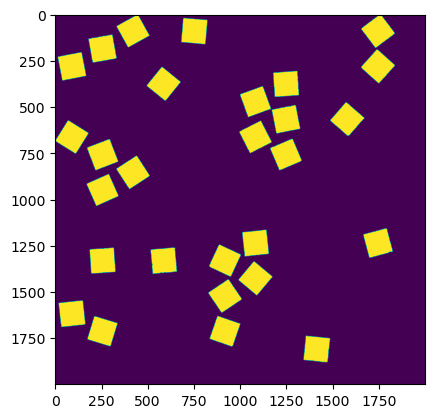

In [12]:
im = load_input_image(0)
md = segment_image_canny(im)
res = apply_mat_morph(md)
plt.imshow(res)

##### Step 3 : Obtain the tiles and their contours

We finally used our **get_contours()** function to extract the contours.

1. We first used **cv2.findContours()**, where each individual contour is a numpy array of (x,y) coordinates of boundary points of the object.

2. With the coordinates, we obtained the rectangle that encloses the contour using **cv2.minAreaRect()**. 

3. To attribute a contour to a tile, we used two conditions: width/height ratio close to 1 and **cv2.contourArea()** > threshold.

4. As the tiles were not straight, we used **cv2.getPerspectiveTransform()** to deal with the tiles’ rotations and obtain the straightened tiles.

5. Contours drawing: we finally used **cv2.drawContours()** for visualization.

6. Then, we save our tiles in a list called all_imgs_tiles.

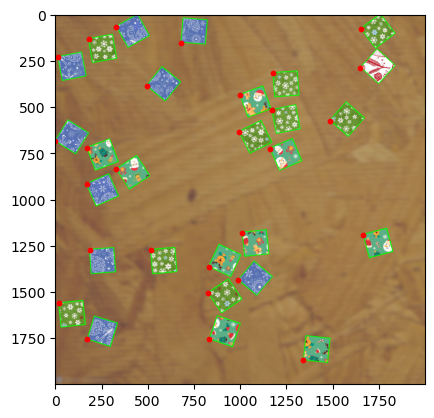

In [13]:
im = load_input_image(0)
md = segment_image_canny(im)
res = apply_mat_morph(md)
final_contours, coords, im_draw, tiles = get_contours(im, res)
plt.imshow(im_draw)
plt.scatter([x for x,y in coords], [y for x,y in coords], c ='r', s=10)

##### Now, let us do that for all of our images.

Image 0: 28 tiles
Image 1: 21 tiles
Image 2: 28 tiles
Image 3: 21 tiles
Image 4: 20 tiles
Image 5: 28 tiles
Image 6: 29 tiles
Image 7: 28 tiles
Image 8: 27 tiles
Image 9: 29 tiles
Image 10: 28 tiles
Image 11: 19 tiles


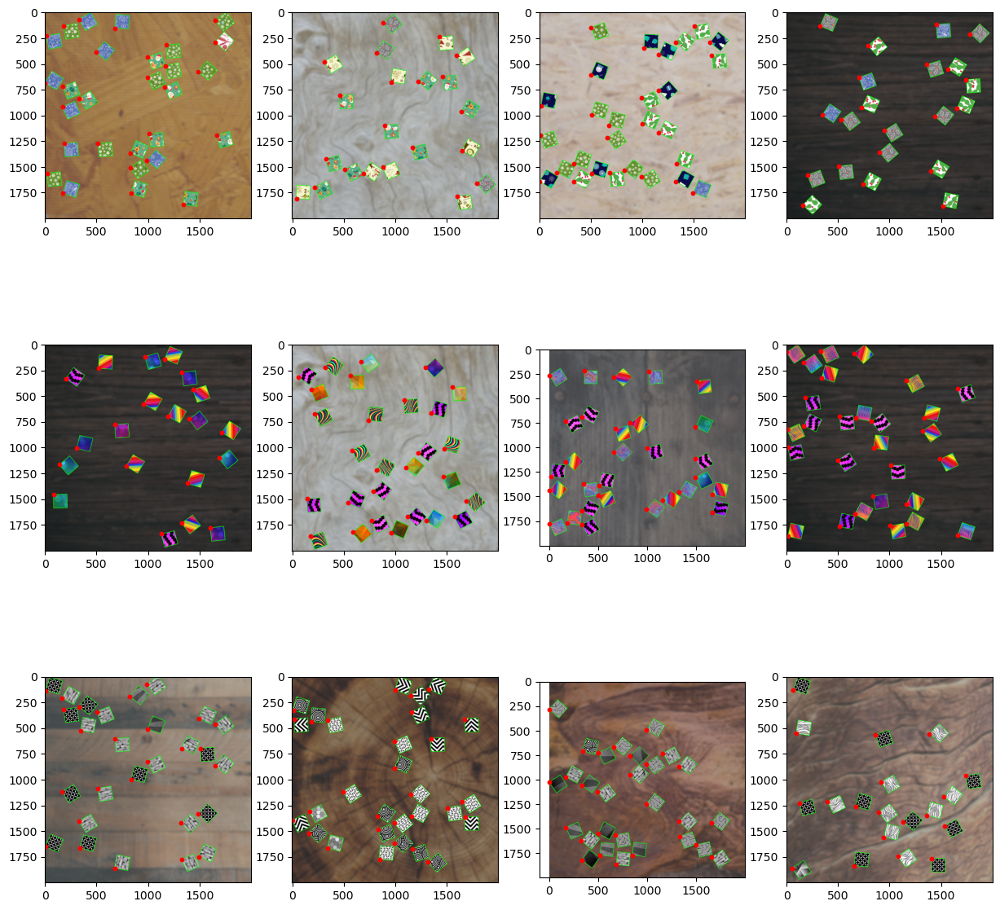

In [14]:
ls = [str(i) for i in range(12)]
# fig, ax = plt.subplot_mosaic([ls], figsize=(15, 15))
fig, axs = plt.subplots(3, 4, figsize=(15, 15))
all_imgs_tiles = []
#mds = []
ress = []
for i, ax in enumerate(axs.flatten()):
    im = load_input_image(i)
    # Segment the image using Canny Edge detection
    md = segment_image_canny(im)
    # Apply Matemathical morphology
    res = apply_mat_morph(md)
    # Append the result
    ress.append(res)
    # Get the contours of the tiles and draw them
    final_contours, coords, im_draw, tiles = get_contours(im, res)

    print(f"Image {i}: {len(tiles)} tiles")
    
    all_imgs_tiles.append(tiles)
    ax.imshow(im_draw)
    ax.scatter([x for x,y in coords], [y for x,y in coords], c='r', s=10)

We can observe that we obtain a very good segmentation for all the tiles, and that the Canny Edge detection works very well with our images.

Let us plot all the tiles obtained from the first image.

28


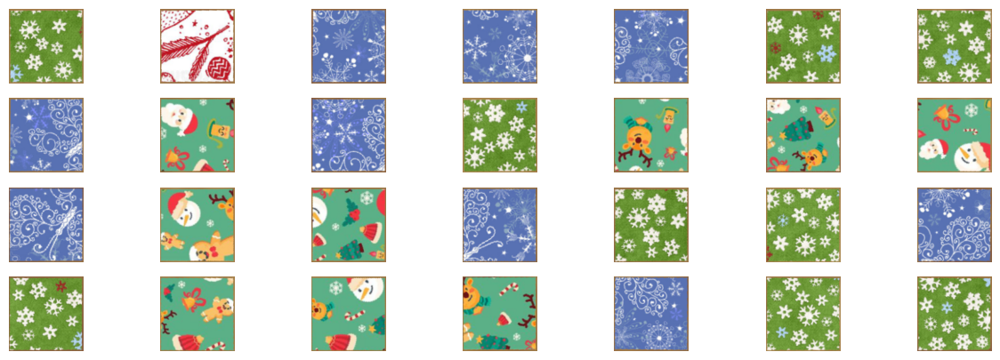

In [15]:
# Show the subplot of the tiles obtained from the first image:
tiles = all_imgs_tiles[0]
print(len(tiles))
r, c = 4, len(tiles)//4
fig, axes = plt.subplots(r, c, figsize=(15, 5))
for i, ax in enumerate(axes.flatten()):
    #print(tiles[i].shape)
    # Resize the images to 128x128 pixels:
    tiles[i] = cv2.resize(tiles[i], (128, 128))
    ax.imshow(tiles[i])
    ax.set_axis_off()
plt.show()

# 2. Extract features of interest from puzzle pieces images

## Gabor filters

$$ gb(x,y) = \exp \left( -\frac{1}{2} \left( \frac{x_{\theta}^2}{\sigma^2} + \frac{y_{\theta}^2}{(\Gamma\sigma)^2} \right) \right) \cos \left( \frac{2 \pi}{\lambda} x_{\theta} + \psi \right) $$


Gabor filter is a type of linear filter used in image processing and computer vision for feature extraction. 

The latter is based on the Gabor function, which is a complex sinusoidal waveform modulated by a Gaussian envelope, as shown by the formula just above. 
It is very useful to detect features like texture and detecting edges with specific orientations or different spatial frequencies.

##### Step 1 : Gabor Kernels

For the feature extraction, a kernel refers to the matrix or mask that defines the spatial pattern of the filter. The kernel is a small matrix, typically square, which is convolved with the image to extract features.

To optimize our features extraction, we chose a  set of kernels to filter the images by varying three values : 
- Thetas: 0-180° (4x) - determines the orientation of the sinusoidal wave in the Gabor filter.
- Sigmas: 1-3 - controls the bandwidth of the Gabor filter, and determines the spread of frequencies that the filter responds to.
- Frequencies:  0.05-0.3 - determines the number of oscillations per unit distance.

We then used the function **skimage.filters.gabor_kernel()** to compute the filters.

In [16]:
# Prepare filter bank kernels
kernels = []
for theta in range(4):
    theta = theta / 4. * np.pi
    for sigma in (1, 3):
        for frequency in [0.05, 0.3]:
            kernel = np.real(gabor_kernel(frequency, theta=theta,
                                          sigma_x=sigma, sigma_y=sigma))
            kernels.append(kernel)

##### Step 2 : convolve the Gabor kernels with our tiles

We then used our compute_gabor_feats() function.

For the convolution of our kernels with tiles, we used the function **scipy.ndimage.convolve()** with the weights being the kernels.

We then extracted a list of features from our convolution: 

- mean
- variance
- skewness 
- kurtosis 
- max 
- min
- standard deviation
- power spectrum
- total power of the signal (sum of the squared spectrum)

##### Step 3 : Color extraction

We used our function get_hist_features() to perform RGB features extraction: we computed RGB ((Red, Green, Blue)) histogram (np.histogram()) of each color channel and added them to the Gabor features.

In [17]:
# Compute color and gabor features for all tiles:
all_imgs_features = []
nbins = 64
for i in range(len(all_imgs_tiles)):
    num_tiles = len(all_imgs_tiles[i])
    img_features = np.zeros((num_tiles, 8*len(kernels)+3*nbins))
    for j in range(num_tiles):
        # Get the tile
        tile = all_imgs_tiles[i][j]
        # Compute the RGB features
        rgb_feats = get_hist_features(tile, bins=nbins)
        # Compute the Gabor features
        gabor_feats = compute_gabor_feats(tile, kernels)
        # Add the Color and Gabor features
        img_features[j, :] = np.concatenate([rgb_feats, gabor_feats.flatten()])
    all_imgs_features.append(img_features)

## Clustering

##### Feature selection

We first tried to select the features using our function **feature_seclection()** that removes features that have low variance, but we noticed that we did not have any 0-variance features.

We also tried to remove the features that were correlated, but even with a threshold of 0.99 it changed the clustering in a less accurate way.

##### K-means algorithm

For our clusters, we used k-mean clustering in our function **cluster()**.

The function first scales the features using the **sklearn.preprocessing.StandardScaler()** (zero mean and variance of 1), then replaced the NaN values with 0s.

We then applied the k-means clustering with the function **sklearn.cluster.KMeans()**, to finally retrieve the labels and centroids of the clusters. 

To chose K, we took the project statement that each image has at least 3 clusters (2 or 3 puzzles and 1 or more outliers), so we took K = 3.
Then, in the case where a cluster have more than 9 tiles and a tile number that is not divisible by 3 or by 4, we re-cluster it with 2 clusters. 

Finally, we re-assign the labels and centroids for that specific case.



Let us try to see what clusters it does for one image first.

cluster 0 has 10 tiles
Image 0


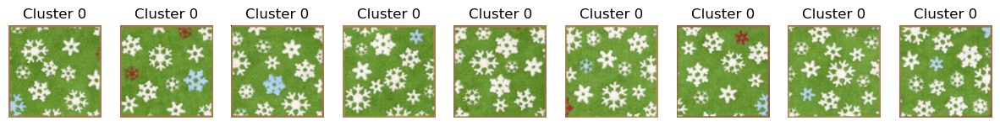

Image 0


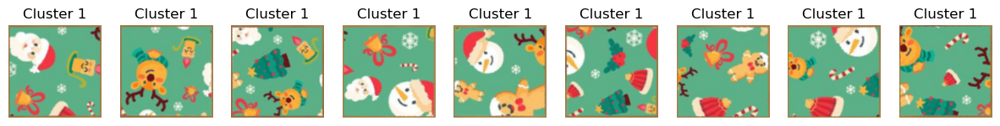

Image 0


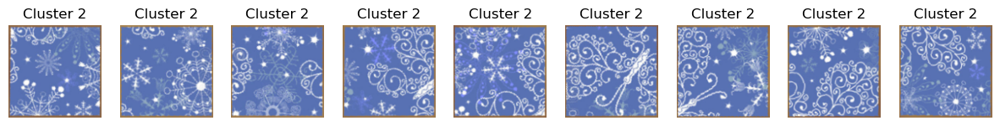

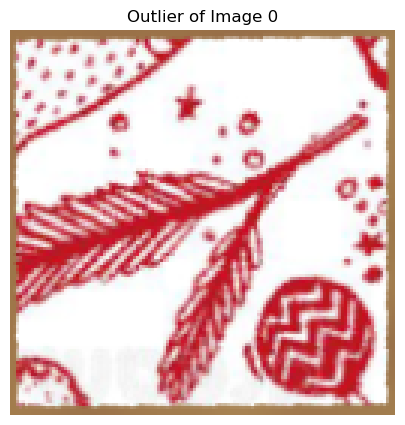

In [18]:
# Single image visualization:
N = 0
K = 3
# Select the feature map for the image 0
feature_map = all_imgs_features[N]
# Select the features by removing features that have low variance - in our case does not change anything
# feature_map = feature_selection(feature_map)
# Plot the clusters:
labels, centroids = cluster(feature_map, n_clusters=K)
l,c = np.unique(labels, return_counts=True)
# plot_clusters(labels, all_imgs_tiles[N])
for i in range(len(l)):
    # Check if each cluster has a number of tiles divisible by 3:
    if c[i] % 3 != 0 and c[i] % 4 != 0 and c[i] > 9:
        print("cluster {} has {} tiles".format(l[i], c[i]))
        # Get the cluster where this happens and recluster it with 2 clusters:
        feature_map = feature_map[labels == l[i]]
        labels_new, centroids = cluster(feature_map, n_clusters=2)
        # Reassign the labels:
        labels_new = [l[i] if label == 0 else l[-1]+1 for label in labels_new]
        # print(labels_new)
        labels[labels == l[i]] = labels_new
        break
clusters = plot_clusters(N, labels, all_imgs_tiles[N])

For the image 0, we can see that the results obtain is accurate : we effectively clustered the tiles of the 3 puzzles with the good cluster. The outlier is also effectively labelled as so.

Let us cluster all of our images.

In [19]:
# To choose K, we hypothesize that each image has at least 3 clusters (2 puzzles + 1 outlier OR 3 puzzles)
# We start by doing k_means clustering with K = 3 and check if each cluster has a number of tiles divisible by 3:
all_labels = []

for N in range(len(all_imgs_features)):
    # Choosing K
    K = 3
    # Get the feature map of the image N
    feature_map = all_imgs_features[N]
    # Remove the features that have low variance - in our case does not change anything
    # feature_map = feature_selection(feature_map)
    # Plot the clusters:
    labels, centroids = cluster(feature_map, n_clusters=K)
    l,c = np.unique(labels, return_counts=True)
    # print(l,c)
    # plot_clusters(labels, all_imgs_tiles[N])
    for i in range(len(l)):
        # Check if each cluster has a number of tiles divisible by 3:
        if c[i] % 3 != 0 and c[i] % 4 != 0 and c[i] > 9: # check if the cluster has more than 9 tiles and is not divisible by 3 or 4
            # print("cluster {} has {} tiles".format(l[i], c[i]))
            # Get the cluster where this happens and recluster it with 2 clusters:
            feature_map = feature_map[labels == l[i]]
            # Get the new label 
            labels_new, centroids = cluster(feature_map, n_clusters=2)
            # Reassign the label
            labels_new = [l[i] if label == 0 else l[-1]+1 for label in labels_new]
            # print(labels_new)
            labels[labels == l[i]] = labels_new
            break
    print("Image {} done".format(N))
               
    #print(labels)
    all_labels.append(labels)

Image 0 done
Image 1 done
Image 2 done
Image 3 done
Image 4 done
Image 5 done
Image 6 done
Image 7 done
Image 8 done
Image 9 done
Image 10 done
Image 11 done


Image 0


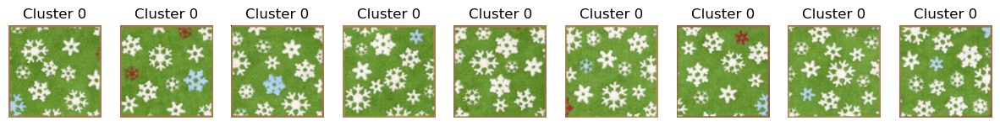

Image 0


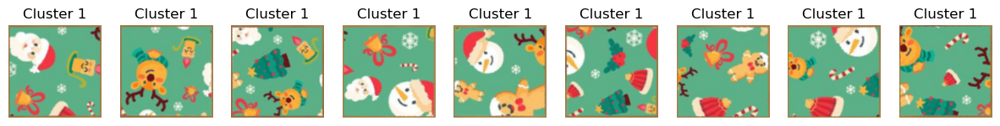

Image 0


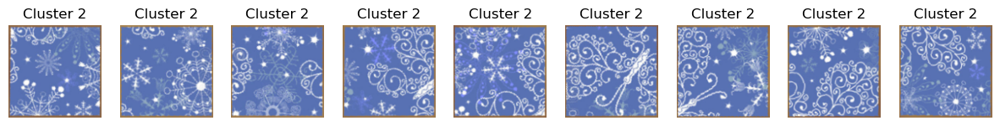

Image 1


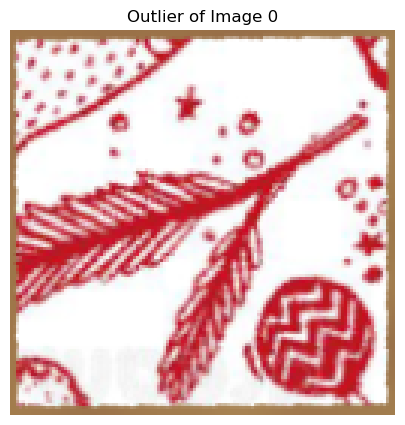

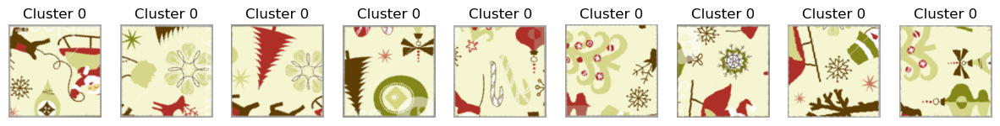

Image 1


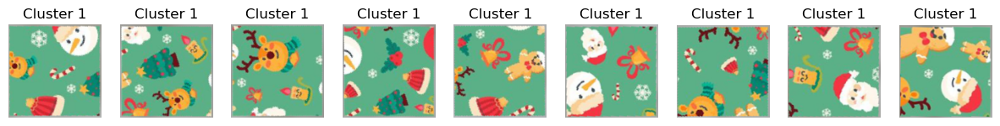

Image 2


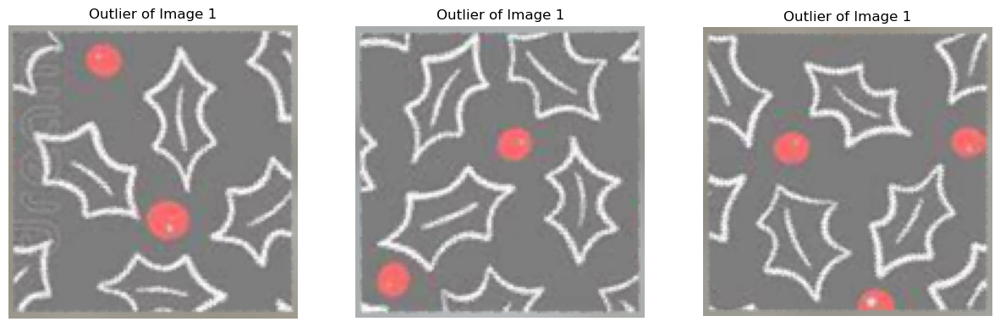

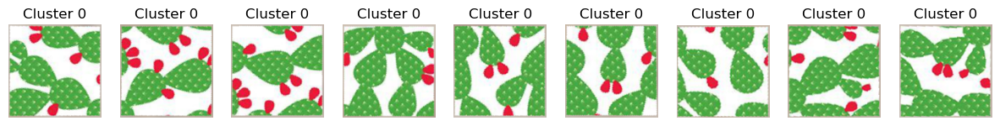

Image 2


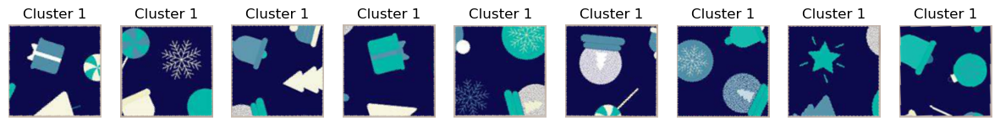

Image 2


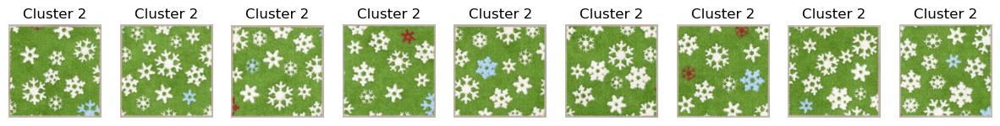

Image 3


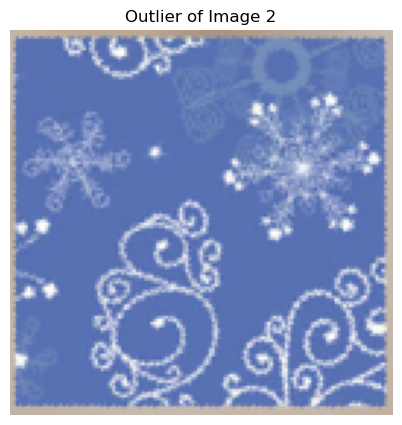

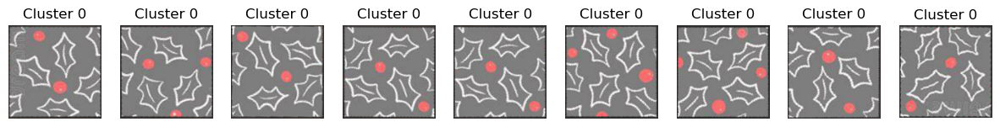

Image 3


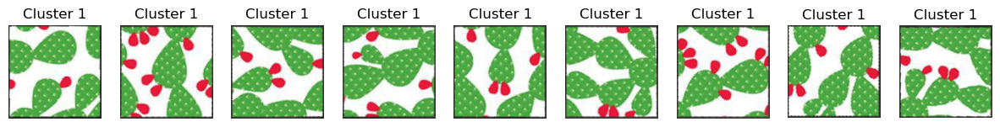

Image 4


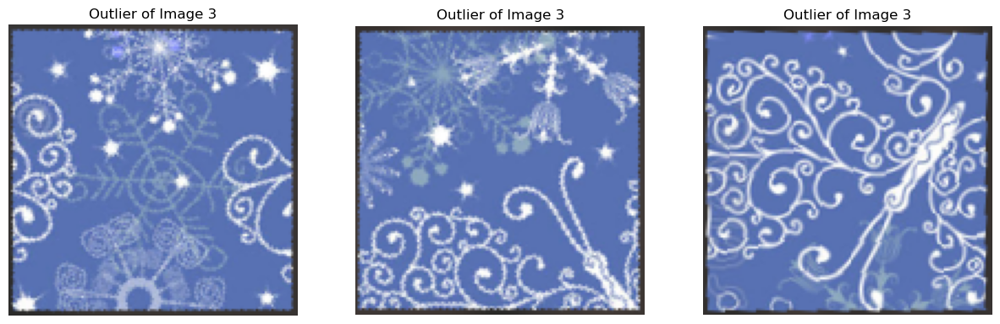

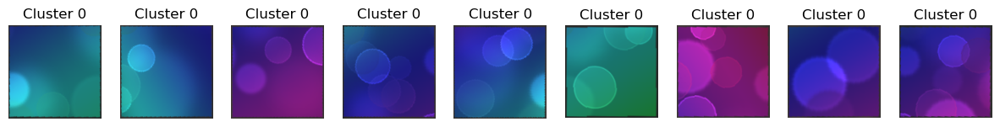

Image 4


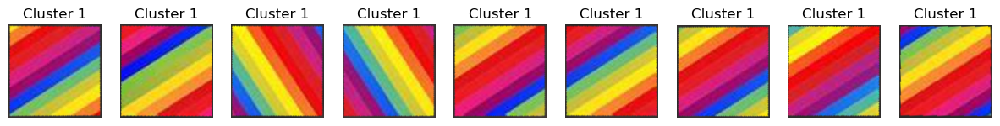

Image 5


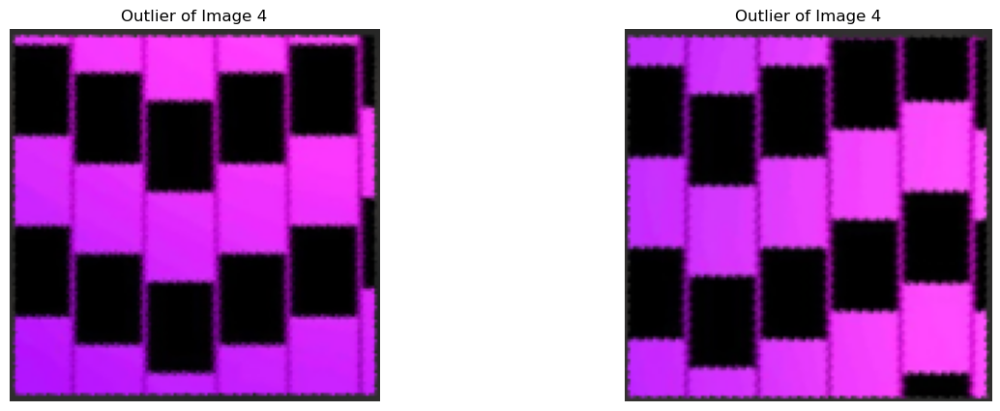

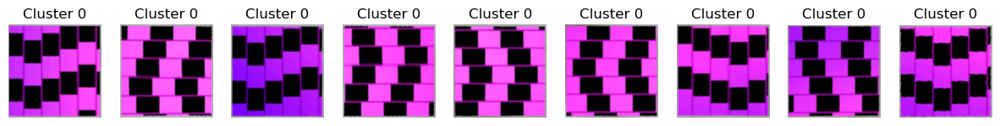

Image 5


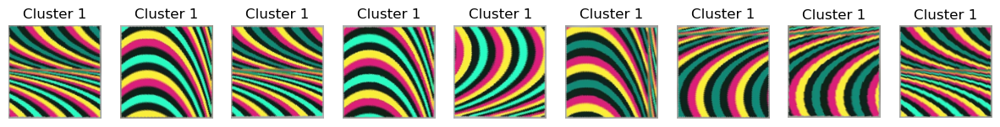

Image 5


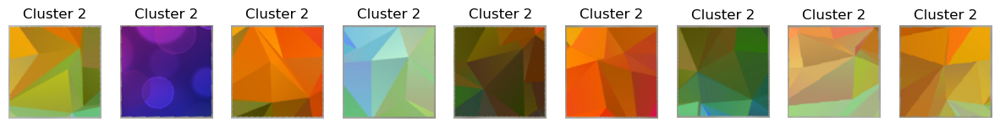

Image 6


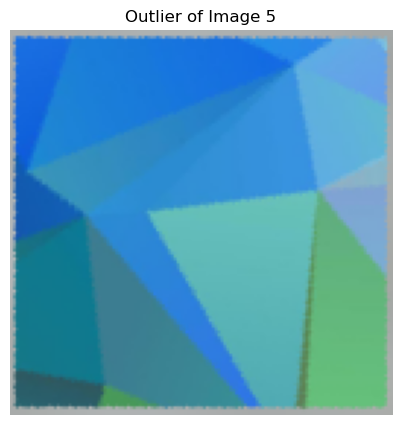

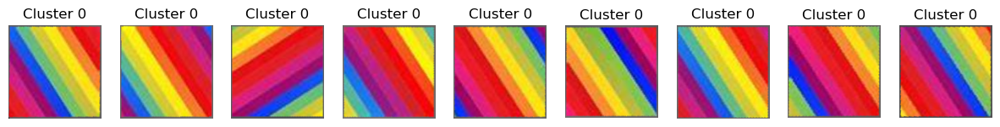

Image 6


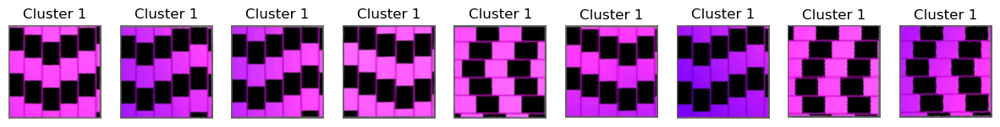

Image 6


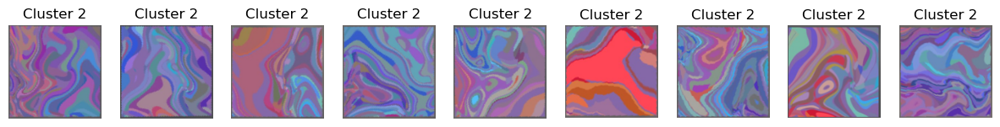

Image 7


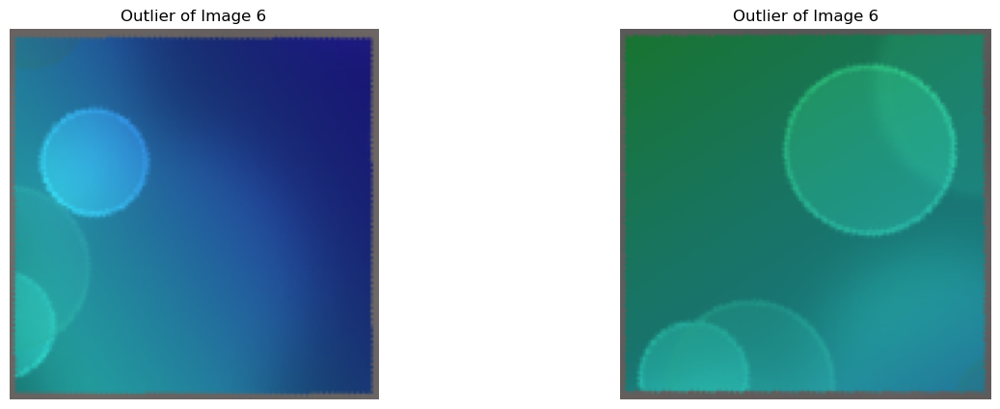

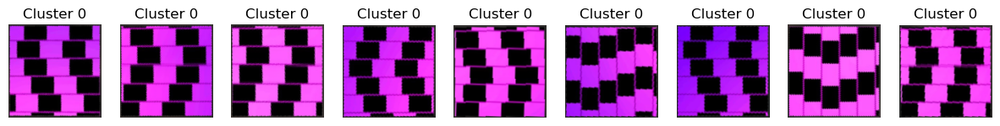

Image 7


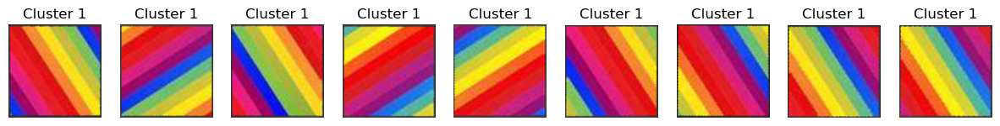

Image 7


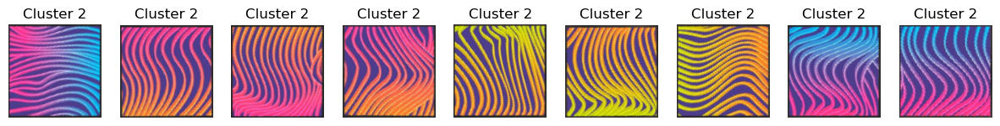

Image 8


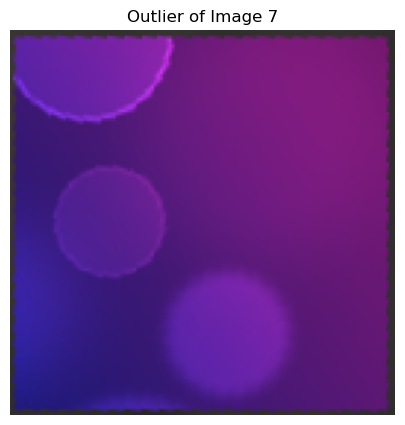

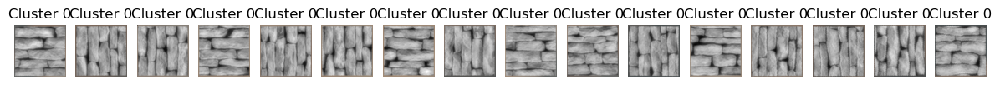

Image 8


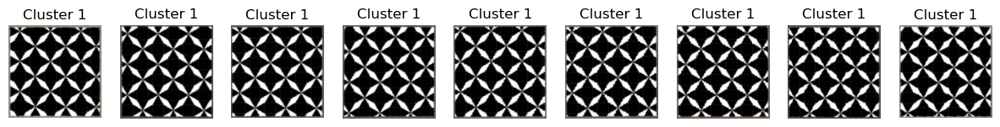

Image 9


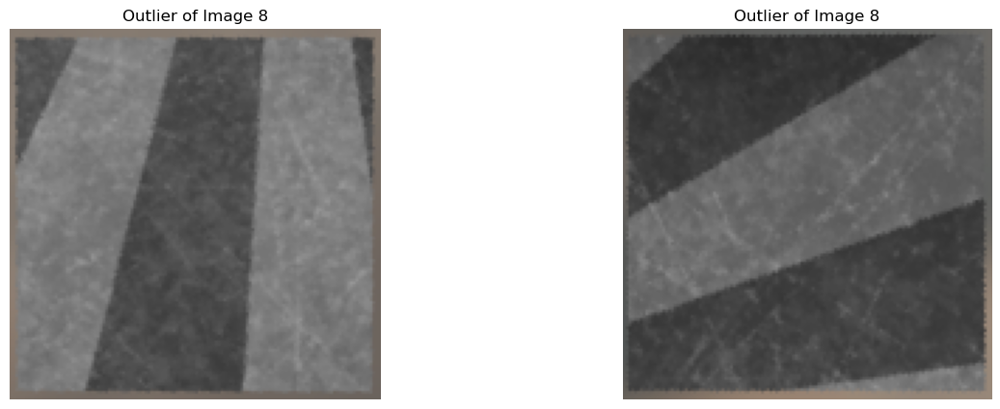

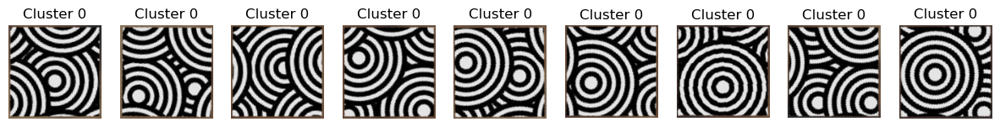

Image 9


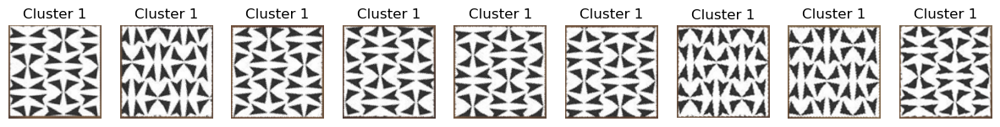

Image 9


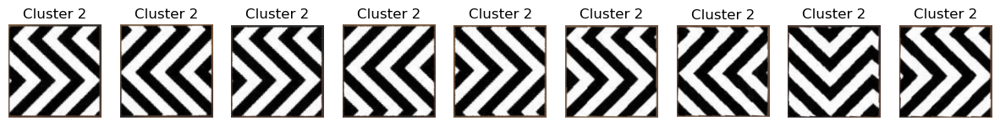

Image 10


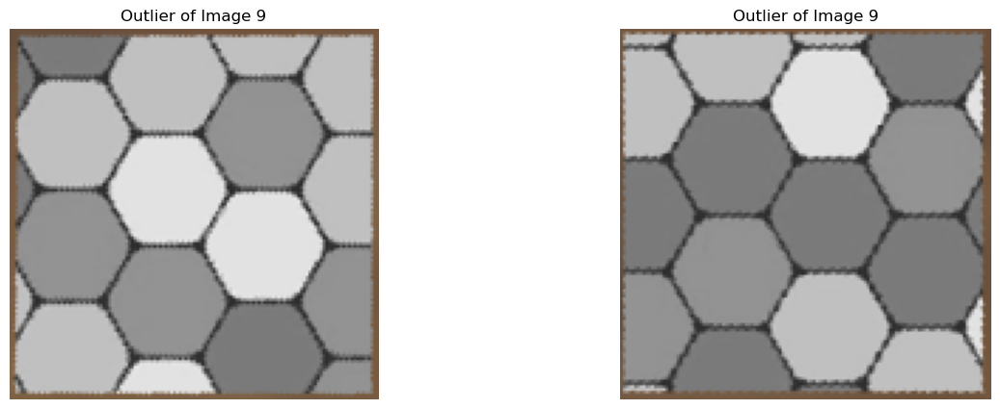

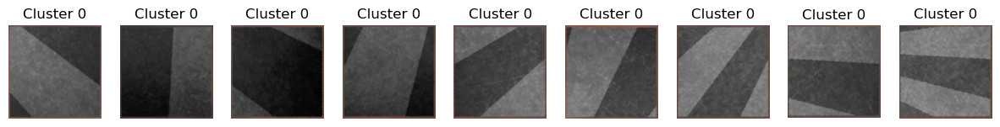

Image 10


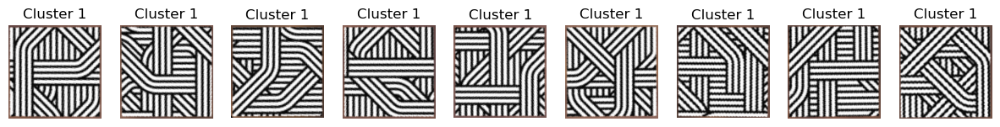

Image 10


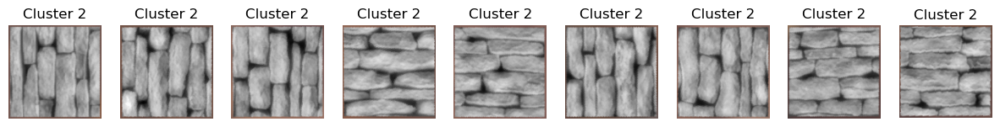

Image 11


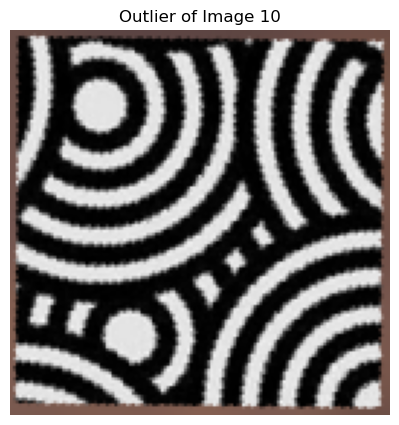

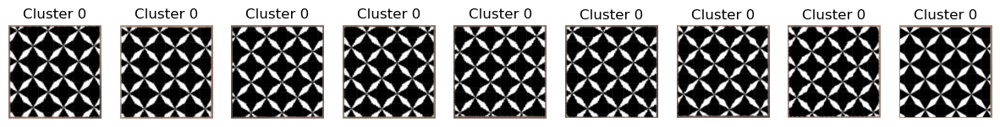

Image 11


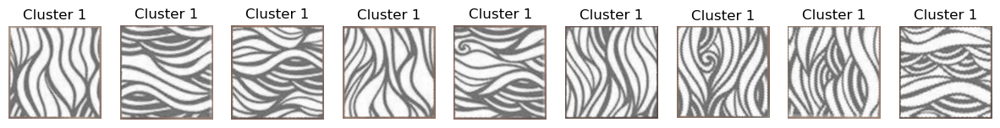

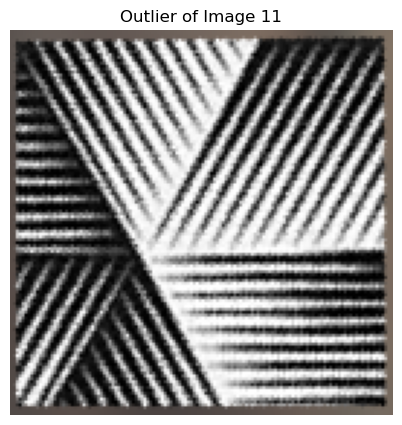

In [20]:
all_clusters = []
for N in range(len(all_labels)):
    clusters = plot_clusters(N, all_labels[N], all_imgs_tiles[N])
    all_clusters.append(clusters)

The k-mean clustering effectively works for almost all of our images, with the correct labels. Beware that the printed "Image i" can overlap with the outlier of the image i-1, so we labeled the outliers of the image as "Outlier of Image i-1".

With the image 5, we see that it did not find the outlier and labeled it as a puzzle.

## Feature selection with PCA

Since our previous feature selection did not yield significant results, we wanted to try do reduce the dimensionality with a PCA.

We replaced the NaN values with the median (it worked better than the mean) this time, and created a function called **dimensionality_reduction**. 

We first scaled the features using the **StandardScaler()** function and used the **sklearn.decomposition.PCA()** function to do a PCA on our features. 
To choose the number of components, we did a trial and error approach, and found that the optimal number was 3 for all of the images.

In [21]:
# from sklearn.experimental import enable_iterative_imputer
# from sklearn.impute import IterativeImputer
from scipy import stats

# For each training image, apply PCA to the feature maps:
all_features_pca = []
for i in range(len(all_imgs_features)):
    feature_maps = all_imgs_features[i]
    # print(f" first {feature_maps.shape}")
    # Drop NaN values:
    # feature_maps = feature_maps[:,~np.(feature_maps).any(axis=0)]
    # replace NaN values with the mean of the column:
    # feature_maps[np.isnan(feature_maps).any(axis=0)] = np.nanmean(feature_maps, axis=1)
    # get index of nan values:

    nan_idx = np.argwhere(np.isnan(feature_maps))
    # # replace nan values with the mean of the column:
    feature_maps[nan_idx[:,0], nan_idx[:,1]] = np.nanmedian(feature_maps[:,nan_idx[:,1]], axis=0)
    # feature_maps[nan_idx[:,0], nan_idx[:,1]] = stats.mode(feature_maps[:,nan_idx[:,1]], axis=0, nan_policy='omit')[0]
    
    # imp_median = IterativeImputer(random_state=0, missing_values=np.nan, initial_strategy='median')
    # imp_median.fit(feature_maps)
    # feature_maps[np.isnan(all_imgs_features[i])] = np.nanmean(feature_maps, axis=0)
    # print(feature_maps.shape)
    feature_maps_pca = dimensionality_reduction(feature_maps)
    all_features_pca.append(feature_maps_pca)

##### Visualize with the image 0

Let us first visualize with the image 0 what it does.

[0 1 2] [10  9  9]
cluster 0 has 10 tiles
Image 0


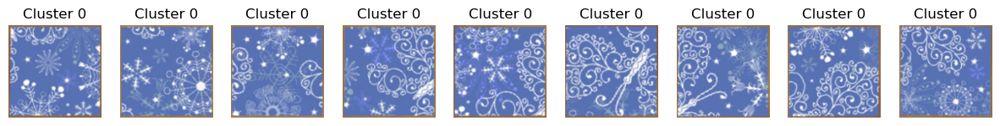

Image 0


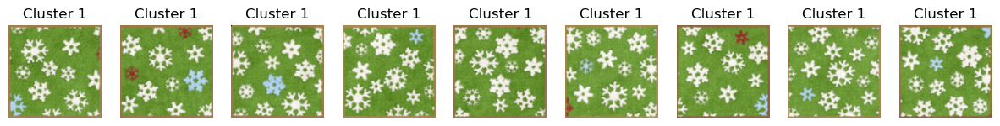

Image 0


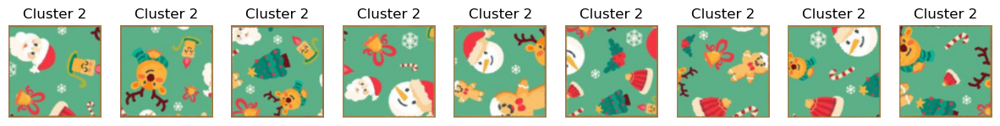

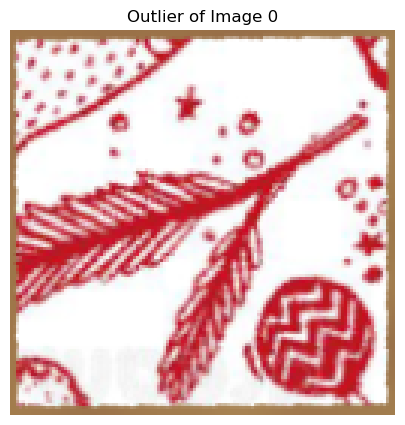

In [22]:
# single image visualization:
N = 0
K = 3
feature_map = all_features_pca[N]
#feature_map = feature_selection(feature_map)
# Plot the clusters:
labels, centroids = cluster(feature_map, n_clusters=K)
l,c = np.unique(labels, return_counts=True)
print(l,c)
# plot_clusters(labels, all_imgs_tiles[N])
for i in range(len(l)):
    # Check if each cluster has a number of tiles divisible by 3, by 4 and if it has more than 9 tiles:
    if c[i] % 3 != 0 and c[i] % 4 != 0 and c[i] > 9:
        print("cluster {} has {} tiles".format(l[i], c[i]))
        # Get the cluster where this happens and recluster it with 2 clusters:
        feature_map = feature_map[labels == l[i]]
        labels_new, centroids = cluster(feature_map, n_clusters=2)
        # Reassign the labels:
        labels_new = [l[i] if label == 0 else l[-1]+1 for label in labels_new]
        # print(labels_new)
        labels[labels == l[i]] = labels_new
        break
# Check if more that one cluster has a number of tiles < 9:
clusters = plot_clusters(N, labels, all_imgs_tiles[N])

We can effectively see that with only 3 components of the PCA, the cluster algorithm still performs greatly.

#### Visualization of the clusters for all the images, with the PCA

In [23]:
# To choose K, we hypothesize that each image has at least 3 clusters (2 puzzles + 1 outlier OR 3 puzzles)
# We start by doing k_means clustering with K=3 and check if each cluster has a number of tiles divisible by 3:
all_labels = []

for N in range(len(all_features_pca)):
    K = 3
    feature_map = all_features_pca[N]
    #feature_map = feature_selection(feature_map)
    # Plot the clusters:
    labels, centroids = cluster(feature_map, n_clusters=K)
    l,c = np.unique(labels, return_counts=True)
    # print(l,c)
    # plot_clusters(labels, all_imgs_tiles[N])
    for i in range(len(l)):
        # Check if each cluster has a number of tiles divisible by 3:
        if c[i] % 3 != 0 and c[i] % 4 != 0 and (c[i] > 9 or c[i]>16): # check if the cluster has more than 9 tiles and is not divisible by 3 or 4
            # print("cluster {} has {} tiles".format(l[i], c[i]))
            # Get the cluster where this happens and recluster it with 2 clusters:
            feature_map = feature_map[labels == l[i]]
            labels_new, centroids = cluster(feature_map, n_clusters=2)
            # Reassign the labels:
            labels_new = [l[i] if label == 0 else l[-1]+1 for label in labels_new]
            # print(labels_new)
            labels[labels == l[i]] = labels_new
            break
    print("Image {} done".format(N))
               
    #print(labels)
    all_labels.append(labels)

Image 0 done
Image 1 done
Image 2 done
Image 3 done
Image 4 done
Image 5 done
Image 6 done
Image 7 done
Image 8 done
Image 9 done
Image 10 done
Image 11 done


Image 0


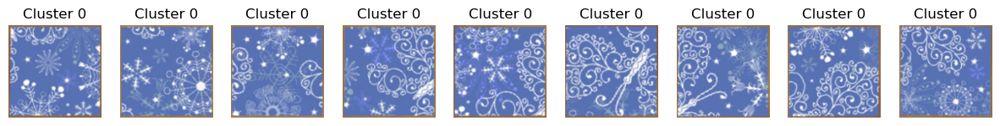

Image 0


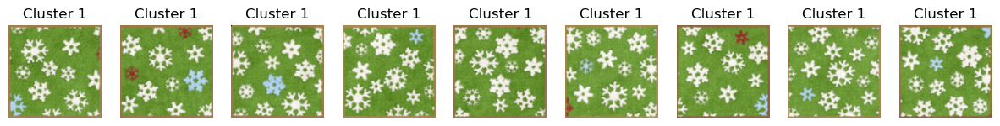

Image 0


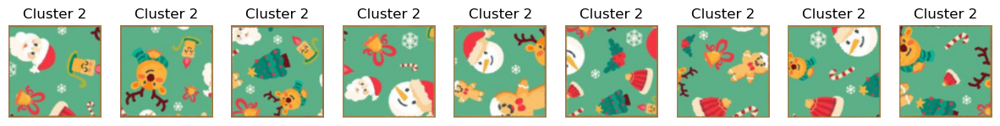

Image 1


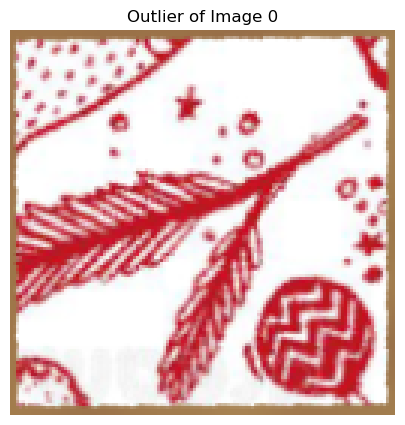

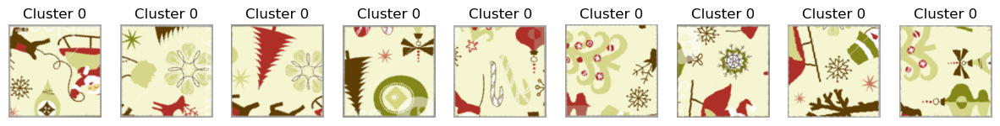

Image 1


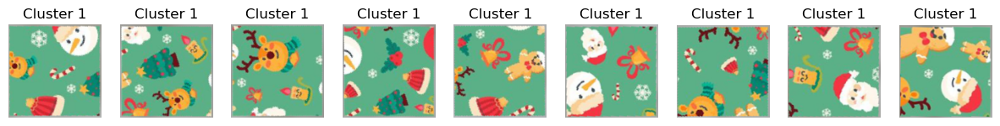

Image 2


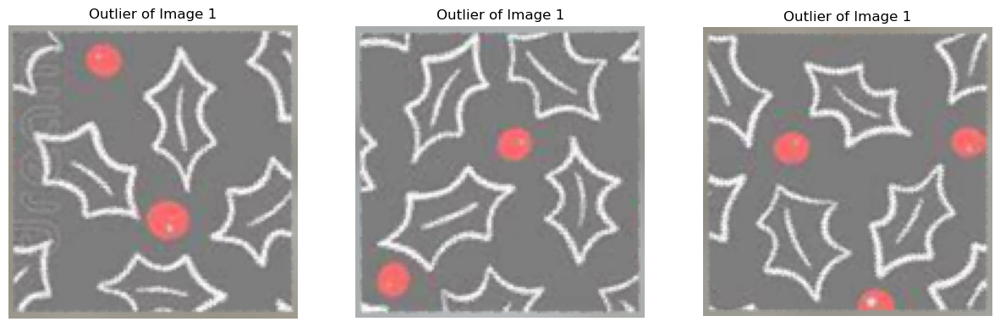

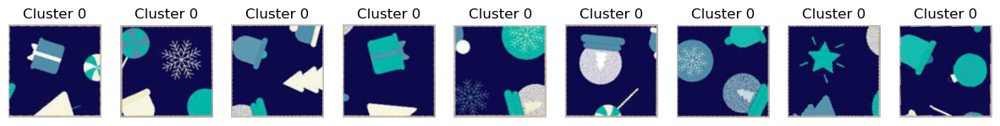

Image 2


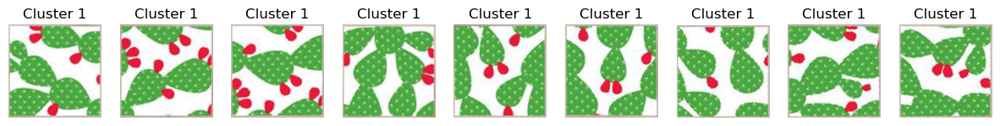

Image 2


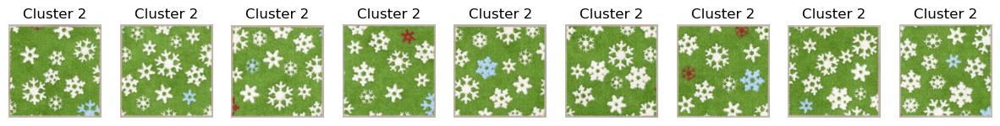

Image 3


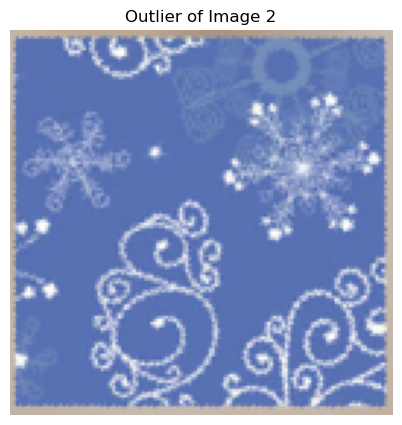

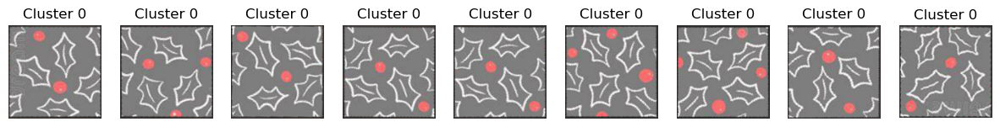

Image 3


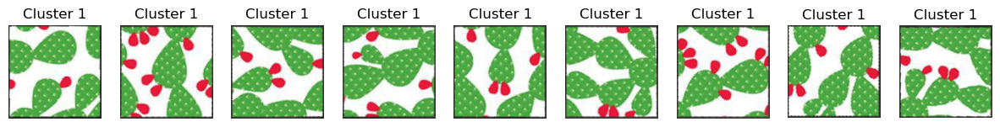

Image 4


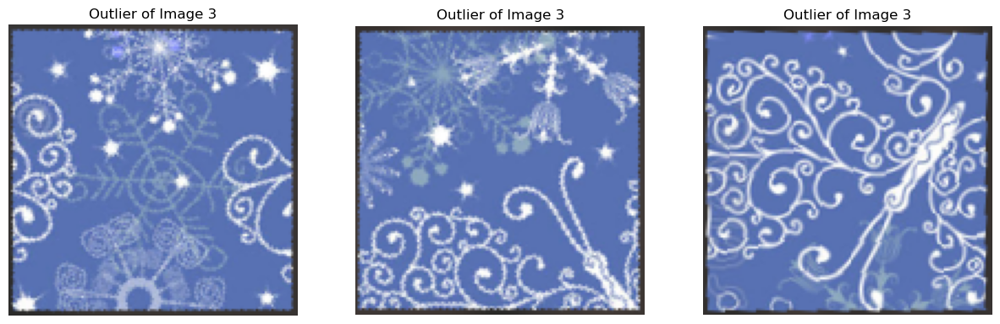

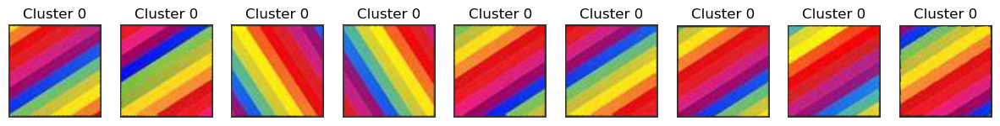

Image 4


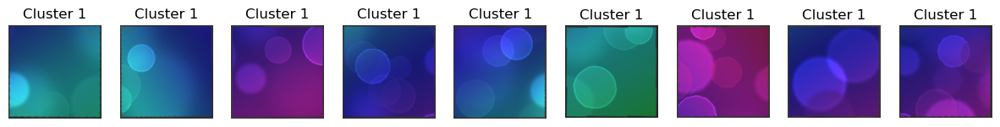

Image 5


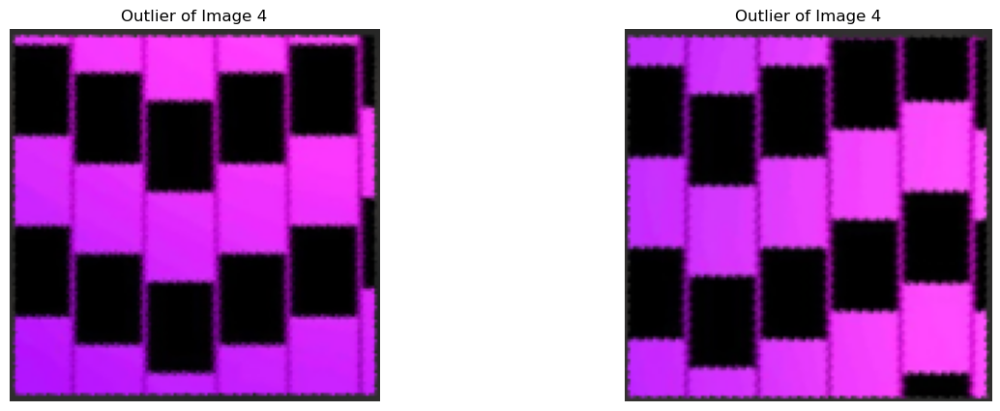

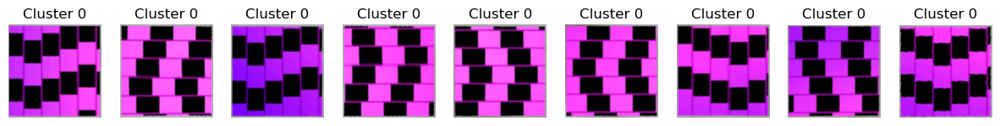

Image 5


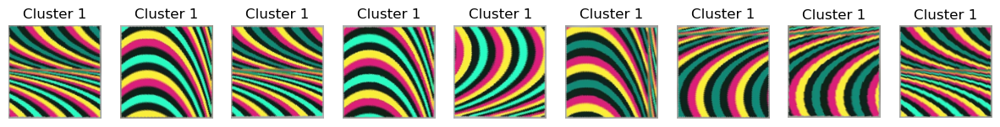

Image 5


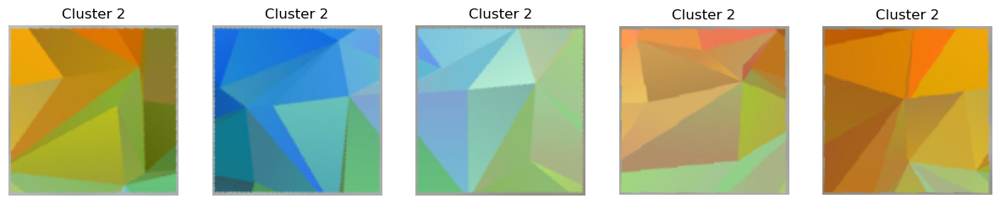

Image 6


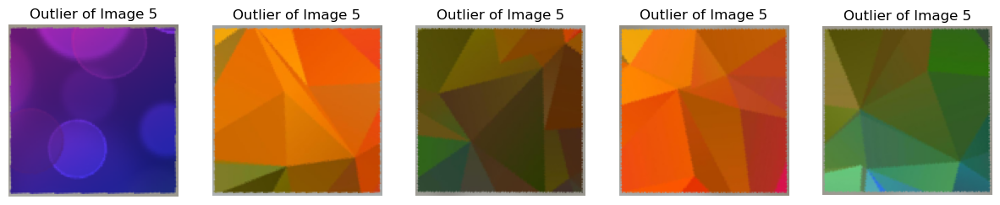

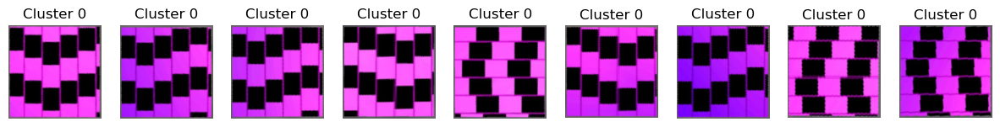

Image 6


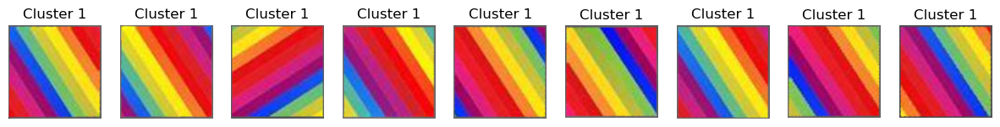

Image 6


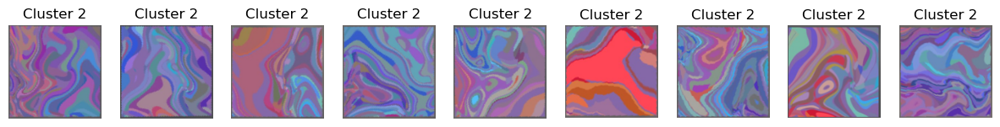

Image 7


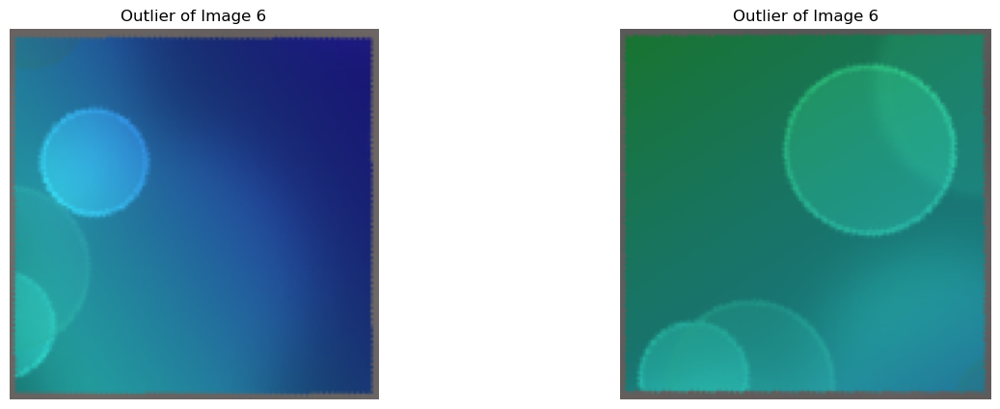

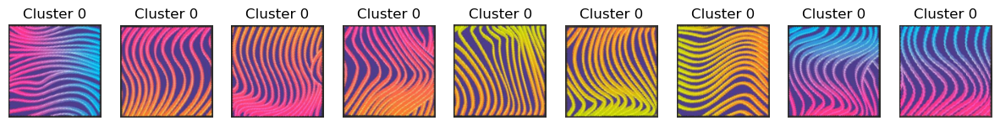

Image 7


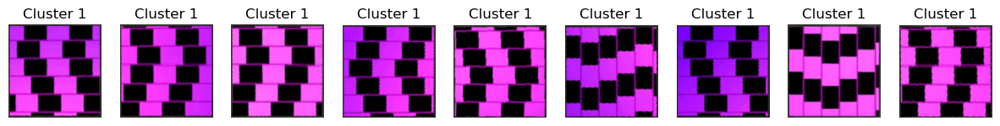

Image 7


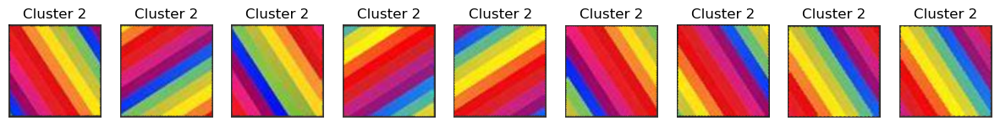

Image 8


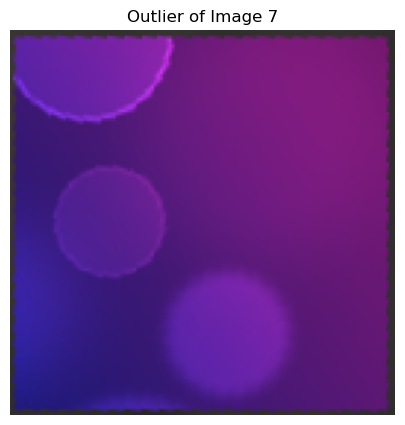

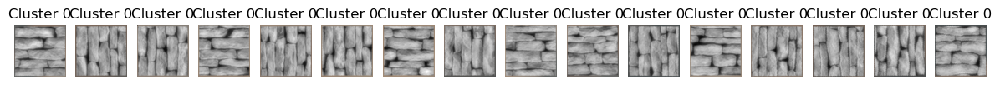

Image 8


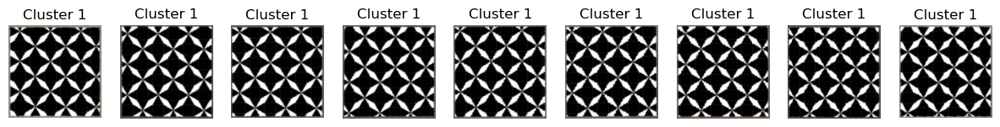

Image 9


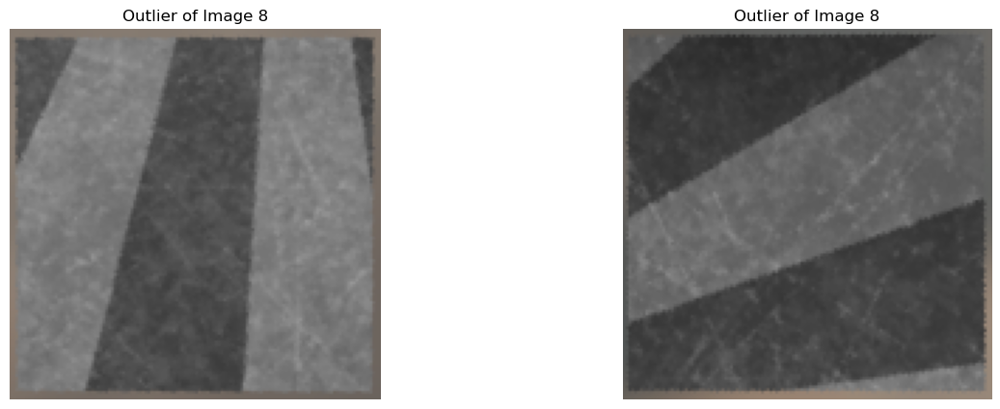

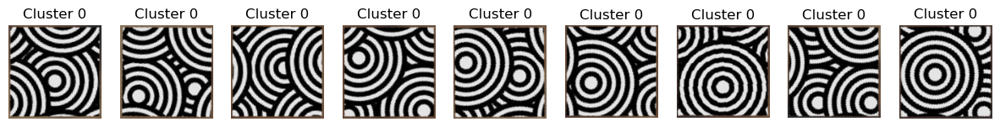

Image 9


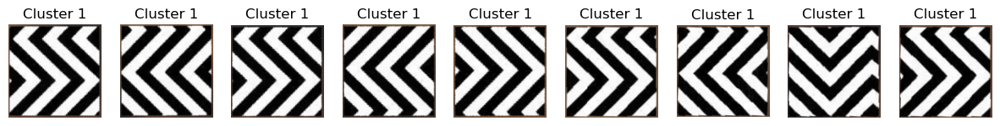

Image 9


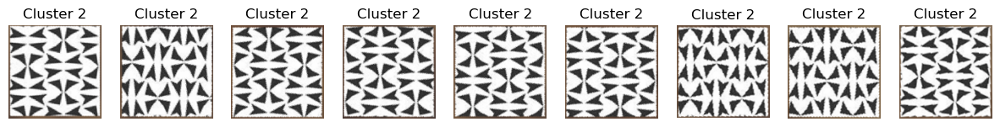

Image 10


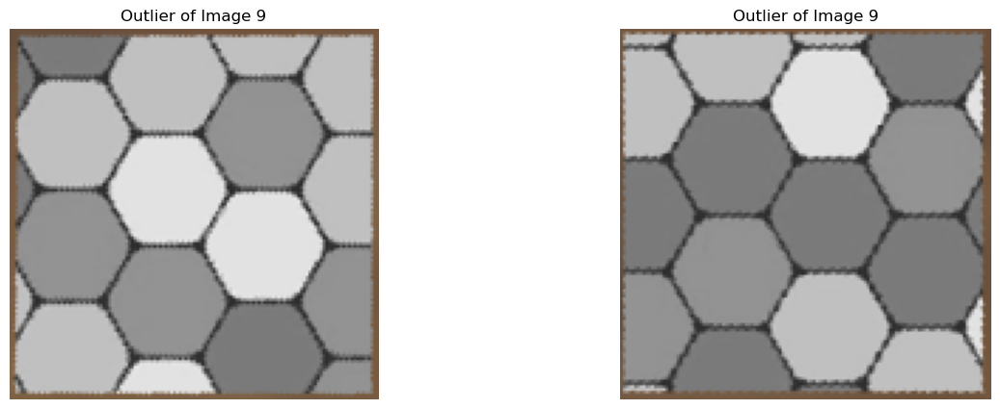

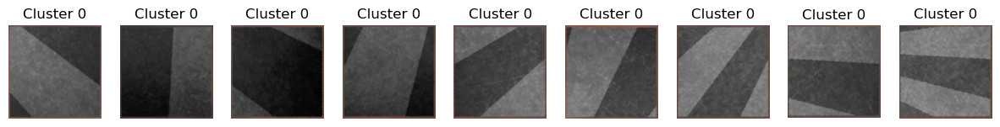

Image 10


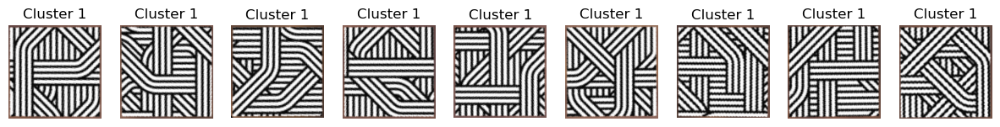

Image 10


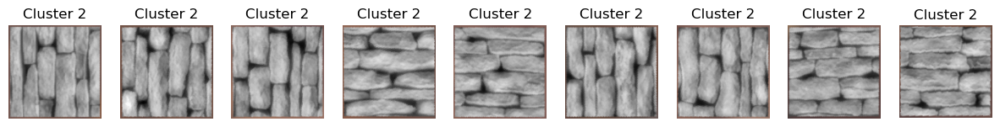

Image 11


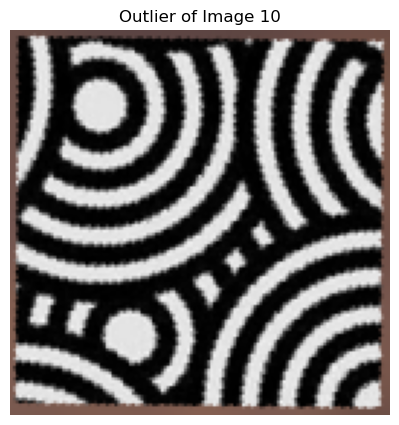

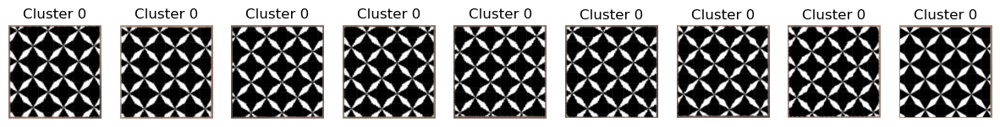

Image 11


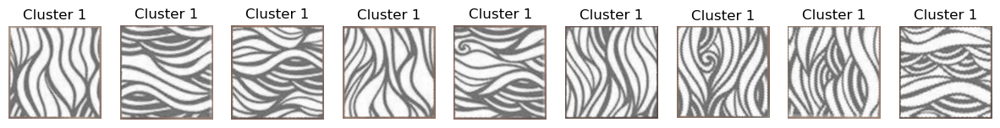

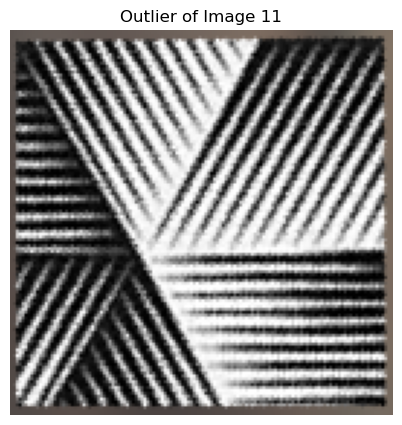

In [24]:
all_clusters_pca = []
for N in range(len(all_labels)):
    clusters = plot_clusters(N, all_labels[N], all_imgs_tiles[N])
    all_clusters_pca.append(clusters)

We have a less accurate clustering than without feature selection of the PCA - we see that for the image 5 the algorithm clustered 4 puzzle pieces as outliers and the true outlier was indeed detected as an outlier but with a wrong cluster.

#### Crop the tiles

#### PCA

In [25]:
# HERE ALL CLUSTERS PCA
# For every tile in each cluster, crop the tiles to remove the black borders and resize them to 128x128 pixels:
all_clusters_cropped = []
for i in range(len(all_clusters_pca)): # Iterate through each image
    clusters_cropped = []
    for j in range(len(all_clusters_pca[i])): # Iterate through the clusters of each image
        cluster_cropped = []
        for k in range(len(all_clusters_pca[i][j])): # Iterate through the tiles of each cluster
            tile = all_clusters_pca[i][j][k]
            # Crop the tile: 
            tile = tile[3:tile.shape[0]-3, 3:tile.shape[1]-3]
            # Resize it: 
            tile = cv2.resize(tile, (128, 128))
            cluster_cropped.append(tile)
        clusters_cropped.append(cluster_cropped)
    all_clusters_cropped.append(clusters_cropped)

#### Without PCA

In [26]:
# DON'T ERASE THIS
# For every tile in each cluster, crop the tiles to remove the black borders and resize them to 128x128 pixels:
# all_clusters_cropped = []
# for i in range(len(all_clusters)): # iterate through each image
#     clusters_cropped = []
#     for j in range(len(all_clusters[i])): # iterate through the clusters of each image
#         cluster_cropped = []
#         for k in range(len(all_clusters[i][j])): # iterate through the tiles of each cluster
#             tile = all_clusters[i][j][k]
#             # crop the tile: 
#             tile = tile[3:tile.shape[0]-3, 3:tile.shape[1]-3]
#             # resize it: 
#             tile = cv2.resize(tile, (128, 128))
#             cluster_cropped.append(tile)
#         clusters_cropped.append(cluster_cropped)
#     all_clusters_cropped.append(clusters_cropped)

In [ ]:
solved_puzzles = []
for i in range(len(all_clusters_cropped)): # iterate through each image
    solved_puzzles_per_image = []
    for j in range(len(all_clusters_cropped[i])): # iterate through the clusters of each image
        # don't include the last cluster if it contains outliers
        if j== len(all_clusters_cropped[i])-1 and len(all_clusters_cropped[i][j])<9: 
            continue
        solved_puzzles_per_image.append(get_puzzle(all_clusters_cropped[i][j], i, j))
    solved_puzzles.append(solved_puzzles_per_image)

Error in the number of tiles of cluster 2 of image 5. 5 tiles found. Black tiles will be added.
uint8


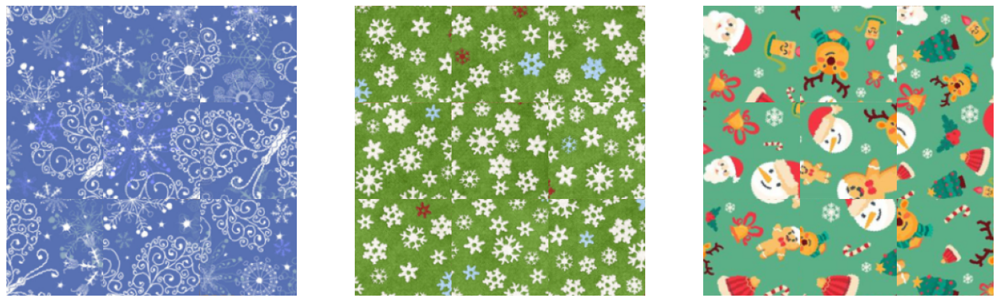

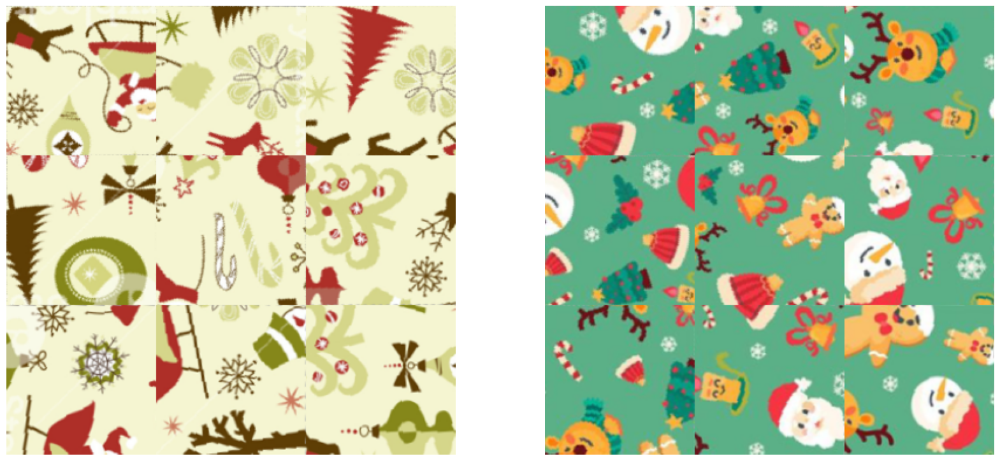

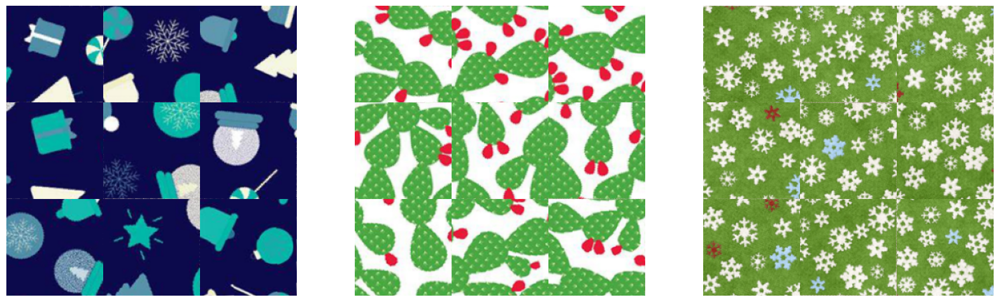

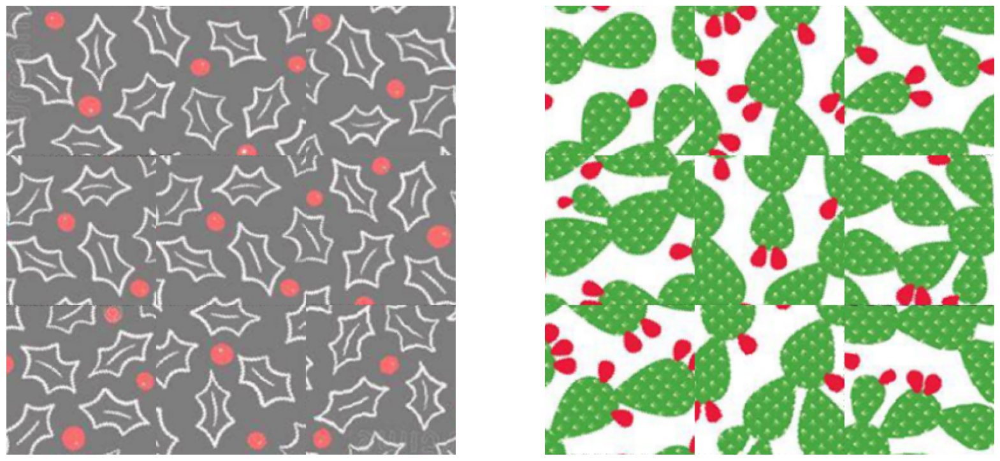

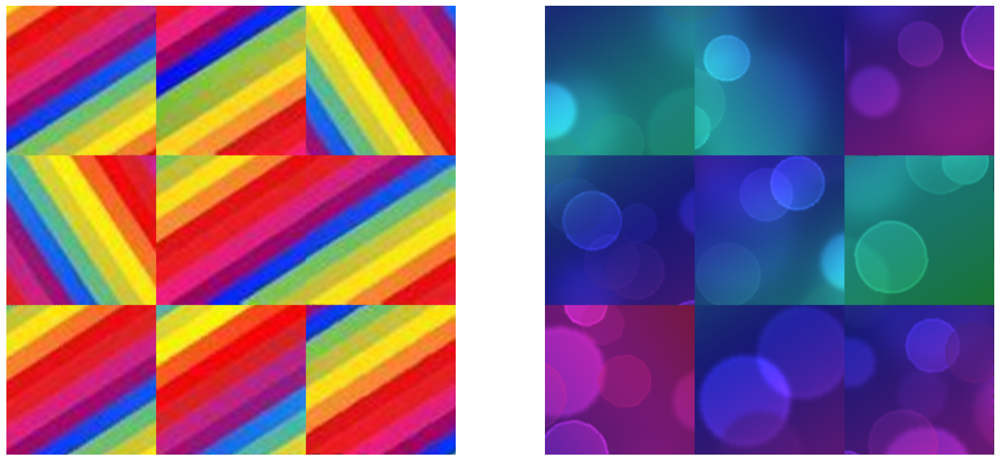

...

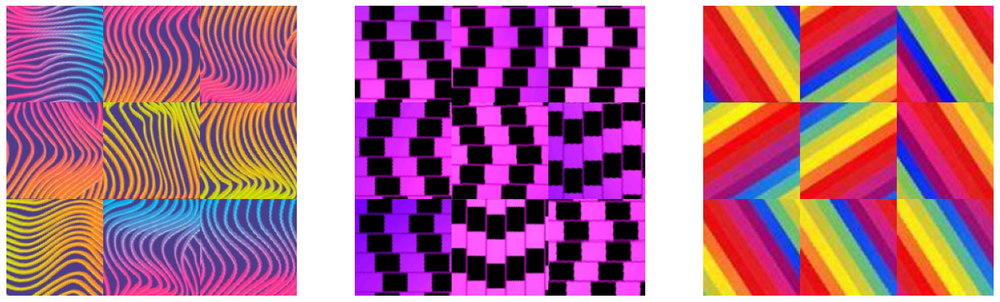

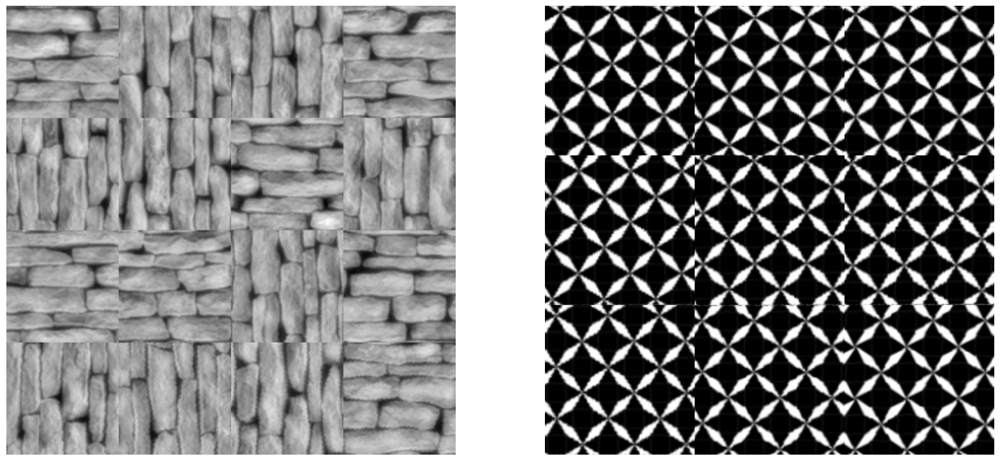

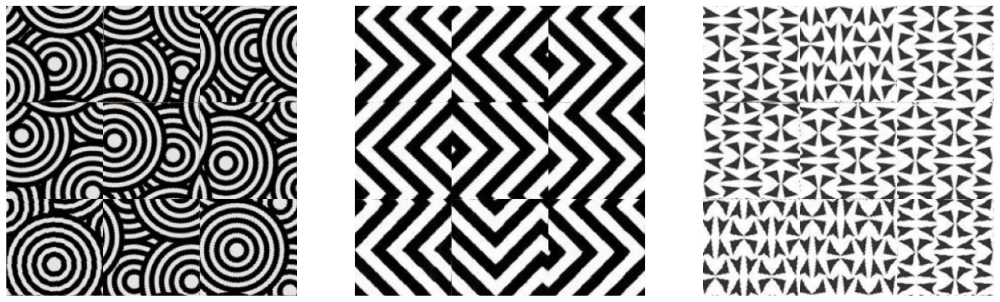

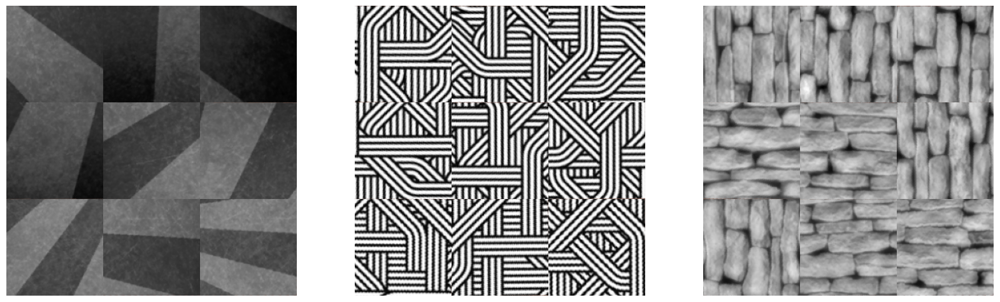

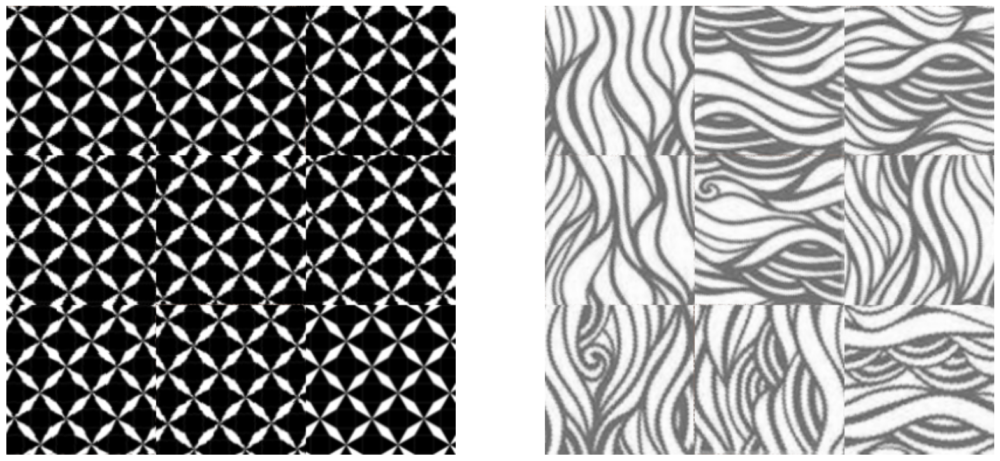

In [ ]:
for i in range(len(solved_puzzles)):    
    fig, ax = plt.subplots(1, len(solved_puzzles[i]), figsize=(20, 10))
    for j in range(len(solved_puzzles[i])):
        ax[j].imshow(solved_puzzles[i][j])
        ax[j].axis('off')

#### With PCA

In [ ]:
# for each image in the training set, export the solutions with the "export_solutions" function:
# for i in range(len(all_imgs_tiles)):
#     solution = [ress[i], all_features_pca[i], all_clusters_cropped[i], solved_puzzles[i]]
#     print(solution)
#     export_solutions(i, solution, path = "data_project", group_id = "02")

#### Without PCA

In [ ]:
# # for each image in the training set, export the solutions with the "export_solutions" function:
# for i in range(len(all_imgs_tiles)):
#     solution = [ress[i], all_imgs_features[i], all_clusters_cropped[i], solved_puzzles[i]]
#     print(solution)
#     export_solutions(i, solution, path = "data_project", group_id = "02")

## Reconstruction trials:

### Image stitching

(128, 128, 3)


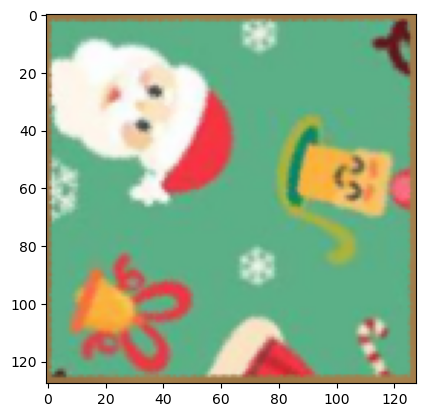

(128, 128, 3)


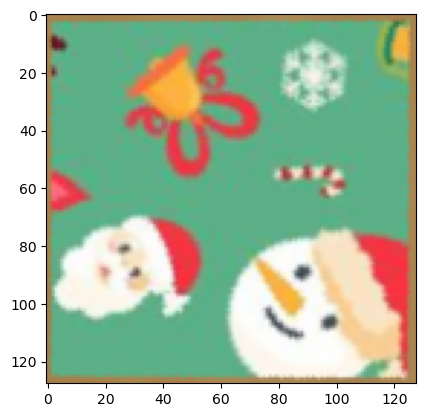

In [42]:
tile1 = all_clusters[0][1][0]
tile2 = all_clusters[0][1][3]
plt.imshow(tile1)
print(tile1.shape)
plt.show()
plt.imshow(tile2)
print(tile2.shape)
plt.show()

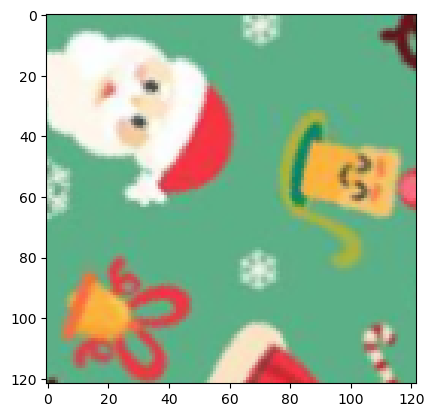

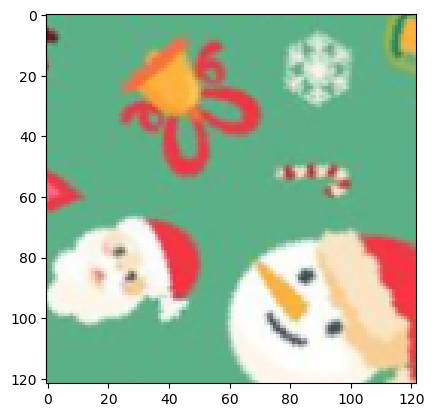

(122, 122, 3)
(122, 122, 3)


In [43]:
# remove the borders:
tile1 = tile1[3:tile1.shape[0]-3, 3:tile1.shape[1]-3]
tile2 = tile2[3:tile2.shape[0]-3, 3:tile2.shape[1]-3]
plt.imshow(tile1)
plt.show()
plt.imshow(tile2)
plt.show()
print(tile1.shape)
print(tile2.shape)

(128, 128, 3)


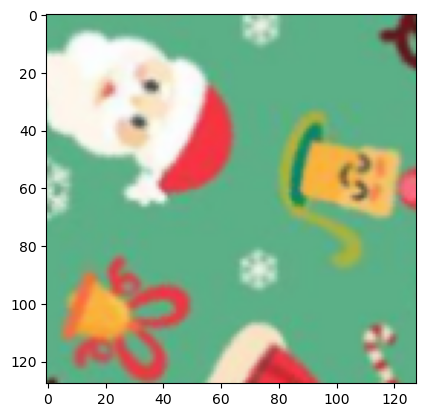

(128, 128, 3)


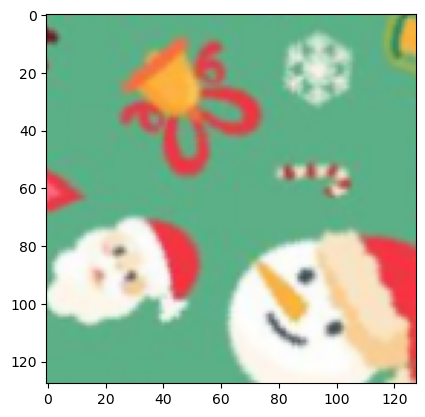

In [44]:
# reshape tiles to 128x128:
tile1 = cv2.resize(tile1, (128, 128))
tile2 = cv2.resize(tile2, (128, 128))
plt.imshow(tile1)
print(tile1.shape)
plt.show()
plt.imshow(tile2)
print(tile2.shape)
plt.show()

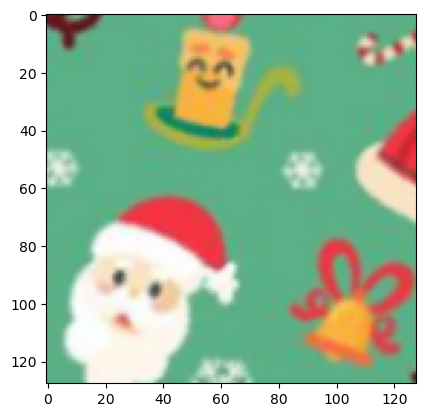

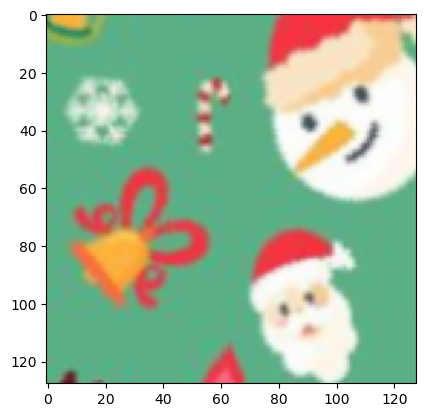

In [45]:
# Rotate both tiles of 90 degrees to the left:
tile1 = np.rot90(tile1, k=1)
tile2 = np.rot90(tile2, k=1)
plt.imshow(tile1)
plt.show()
plt.imshow(tile2)
plt.show()

In [46]:
cluster = [tile1, tile2]

First, we tried manual reconstruction, but we didn't find the correct rotation for every puzzle image.

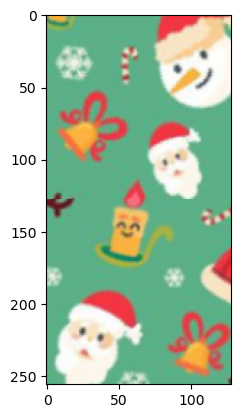

In [47]:
dst = np.zeros((cluster[0].shape[0]*2, cluster[0].shape[1],3), dtype=np.uint8)
dst[0:cluster[1].shape[0], 0:cluster[1].shape[1]] = cluster[1]
dst[cluster[1].shape[0]:, 0:cluster[1].shape[1]] = cluster[0]
plt.imshow(dst)
plt.show()

Then, we tried image stiching. Image stitching is the process of combining multiple photographic images with overlapping fields of view to produce a segmented panorama or high-resolution image. However, most approaches to image stitching require nearly exact overlaps between images and identical exposures to produce seamless results, which does not apply in our case. In our case, we tried to detect the SIFT features that are common to two images and then we tried to stitch them together using the best matches based on the distance metric. We used the OpenCV library to do this. The SIFT features are detected using the SIFT algorithm. The SIFT algorithm is a feature detection algorithm that detects and describes local features in images. The algorithm was published by David Lowe in 1999. The algorithm works by detecting distinctive invariant features in an image and then describe each of these features using a vector based on the values of its neighboring pixels.

In [48]:
def stitching(cluster):
    """ This function computes matching features between pieces and stitches them together """
    #1. Transform images in grayscale:
    gray1 = cv2.cvtColor(cluster[0], cv2.COLOR_RGB2GRAY)
    gray2 = cv2.cvtColor(cluster[1], cv2.COLOR_RGB2GRAY)
    #1. Compute the sift-keypoints and descriptors for the images:
    sift = cv2.SIFT_create()
    # find the keypoints and descriptors with SIFT
    kp1, des1 = sift.detectAndCompute(cluster[0],None)
    kp2, des2 = sift.detectAndCompute(cluster[1],None)
    #2. Compute the matches between the two images:
    # create BFMatcher object
    bf = cv2.BFMatcher()
    # Match descriptors.
    matches = bf.knnMatch(des1,des2, k=2)
    # Apply ratio test
    good = []
    for m,n in matches:
        #print(m,n)
        if m.distance < 0.5*n.distance:
            good.append([m])
    matches = np.asarray(good)
    #print(matches)
    #print("Number of matches: {}".format(len(matches)))
    #3. Compute the homography matrix:
    # Extract location of good matches
    imMatches = cv2.drawMatches(cluster[0], kp1, cluster[1], kp2, matches[:10,0], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    cv2.imwrite("matches.jpg", imMatches)
    if len(matches[:,0]) >= 4:
        src = np.float32([kp1[m.queryIdx].pt for m in matches[:,0]]).reshape(-1,1,2)
        dst = np.float32([kp2[m.trainIdx].pt for m in matches[:,0]]).reshape(-1,1,2)
        H, masked = cv2.findHomography(src, dst, cv2.RANSAC, 5.0) # findHomoGraphy returns a 3x3 matrix H which transforms points from the first image to the second image 
        # masked is a mask which specifies the inlier and outlier points
        #print H
    else:
        raise AssertionError("Can't find enough keypoints.")
    # 4. Warp to align for stitching
    dst = cv2.warpPerspective(cluster[0],H,(cluster[1].shape[1], cluster[1].shape[1] + cluster[0].shape[1]))
    plt.imshow(dst)
    plt.title("Warped Image")
    plt.show()
    plt.figure()
    print(dst.shape)
    dst[0:cluster[1].shape[0], 0:cluster[1].shape[1]] = cluster[1]
    dst[cluster[1].shape[0]:, 0:cluster[1].shape[1]] = cluster[0]
    plt.imshow(dst)
    plt.show()


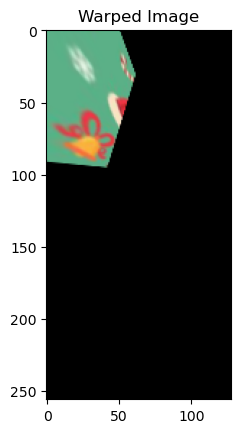

(256, 128, 3)


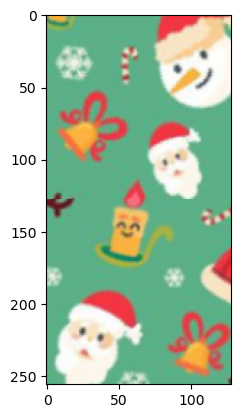

In [49]:
stitching(cluster)

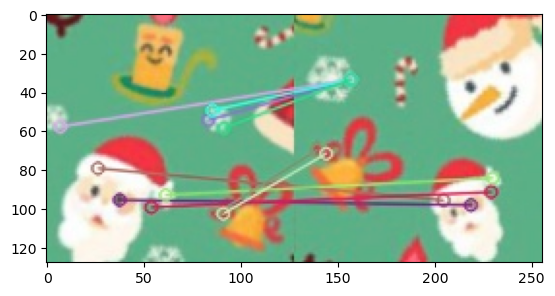

In [50]:
# Output the "matches.jpg" file from the stitching function:
plt.imshow(cv2.imread("matches.jpg"))

As we can see, the matches are detecting the image details that are similar between the tiles and not the corresponding edges. Hence, the warped image gives a bad reconstruction because it is stitching the image not at the edges but at location inside the images. 

### Convolutional Neural Network
We got inspiration by the public GitHub repository https://github.com/anilsathyan7/Jigsaw-Net/tree/master that used a CNN to solve a Jigsaw puzzles with shuffled and rotated tiles, as we have in our case. The authors of the repository provide a pre-trained model, but it cannot be used in our case because it was trained on one image only, for puzzles that are 4x4 only. Therefore, we adapted the code of their model and retrained it. Unfortunately we were unable to perform the training because the RAM of our computers were insufficient. Also on Kaggle, the RAM wasn't enough.   
We think that this is still a powerful approach that might resolve the puzzle, but we would need more powerful computers and GPUs to train the model. 

In [ ]:
import tensorflow as tf
# import keras
from tensorflow.keras import Model
from tensorflow.keras.layers import Dense, Input, concatenate, Conv2D, Reshape,MaxPooling2D, Lambda,Activation,Conv2DTranspose, UpSampling2D
from tensorflow.keras.layers import UpSampling2D, Conv2DTranspose, BatchNormalization, Dropout
from tensorflow.keras.callbacks import TensorBoard, ModelCheckpoint, Callback, ReduceLROnPlateau
from tensorflow.keras.regularizers import l1
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers.legacy import SGD, Adam
import tensorflow.keras.backend as K
from keras.backend import tf as ktf
from tensorflow.keras.utils import plot_model
from tensorflow.keras.callbacks import TensorBoard, ModelCheckpoint, Callback
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage.filters import gaussian_filter
from random import randint
import random
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from PIL import Image
from imageio import imsave
from skimage.util.shape import view_as_blocks
from scipy import stats
import matplotlib.pyplot as plt
from random import randint
%matplotlib inline

C:\Users\chiar\AppData\Local\Temp\ipykernel_53864\3346278690.py:16: DeprecationWarning: Please use `gaussian_filter` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  from scipy.ndimage.filters import gaussian_filter


#### 1. Create the training and validation data
For the training and validation set we started by the provided functions in the `train_solutions` folder provided. We separated the images in blocks of 3x3, 3x4 or 4x4 and computed random permutations and rotations of the blocks. For each image, we generated 1000 different images with this approach and saved the transformations as labels. 
Then, we separated the dataset into training (25\*1000 images) and validation (6\*1000 images).  
We augmented the training and validation data through the ImageDataGenerator() of TensorFlow. 

In [ ]:
#Preprare labels
def label(im, num):

  num_rows, num_cols = num
  blk_size=im.shape[0]//num_rows
  img_lab=np.zeros((im.shape[0], im.shape[1]),dtype=np.uint8)  
  for i in range(0,num_rows):
     for j in range(0,num_cols):
      x,y = i*blk_size, j*blk_size
      img_lab[x:x+blk_size, y:y+blk_size] = np.full((blk_size, blk_size),i*num_rows+j)
                                             
  return img_lab

#Prepare images
def shuffle(im, lb, num, rotate= False):
    num_rows, num_cols = num
    map = {}
    blk_size=im.shape[0]//num_rows
    
    img_blks=view_as_blocks(im,block_shape=(blk_size,blk_size,3)).reshape((-1,blk_size,blk_size,3))
    lbl_blks=view_as_blocks(lb,block_shape=(blk_size,blk_size)).reshape((-1,blk_size,blk_size))
    
    
    img_shuff=np.zeros((im.shape[0],im.shape[1],3),dtype=np.uint8)
    lbl_shuff=np.zeros((lb.shape[0],lb.shape[1]),dtype=np.uint8)
    lbl_rotn=np.zeros((lb.shape[0]//blk_size,lb.shape[1]//blk_size),dtype=np.uint8)
    
    a=np.arange(num_rows*num_cols, dtype=np.uint8)
    b=np.random.permutation(a)
    
    map = {k:v for k,v in zip(a,b)}
    # print ("Key Map:-\n" + str(map))
    
    for i in range(0,num_rows):
        for j in range(0,num_cols):
            x,y = i*blk_size, j*blk_size
            if(rotate):
                rot_val=random.randrange(0,4)
                lbl_rotn[i,j]=rot_val
                # print([i*num_rows + j])
                img_shuff[x:x+blk_size, y:y+blk_size] = np.rot90(img_blks[map[i*num_cols + j]],rot_val)
                lbl_shuff[x:x+blk_size, y:y+blk_size] = lbl_blks[map[i*num_cols + j]]
        else:
            img_shuff[x:x+blk_size, y:y+blk_size] = img_blks[map[i*num_cols + j]]
            lbl_shuff[x:x+blk_size, y:y+blk_size] = lbl_blks[map[i*num_cols + j]]  
    return img_shuff,lbl_shuff,lbl_rotn

def load_solution_images(folder ="train_solutions", path = "data_project"):
    
    # get all the files in the folder that start with "solution"
    files = os.listdir(os.path.join(path,folder))
    files = [f for f in files if f.startswith("solution")]
    im = []
    for i in range(len(files)):
        im.append(np.array(Image.open(os.path.join(path,folder,files[i])).convert('RGB')))

    return im

def get_training_image(original_image):
    im = original_image
    # print(im.shape)
    if im.shape[0]== im.shape[1] == 128*3:
        # add one row and one column of zeros to the image
        im = np.pad(im, ((0,128),(0,128),(0,0)), 'constant')
        lb = label(im, (4,4))
        img_shuff,lbl_shuff,lbl_rotn = shuffle(im, lb, (4,4), True)
        # nine_squares_shuffled.append(img_shuff)
        # nine_labels_shuff.append(lbl_shuff)
        # nine_labels_rot.append(lbl_rotn)
    elif im.shape[1] == 128*3 and  im.shape[0]== 128*4:
        # add one column of zeros to the image
        im = np.pad(im, ((0,0),(0,128),(0,0)), 'constant')
        lb = label(im, (4,4))
        img_shuff,lbl_shuff,lbl_rotn = shuffle(im, lb, (4,4), True)
        # print(img_shuff.shape)
        # twelve_squares_shuffled.append(img_shuff)
        # twelve_labels_shuff.append(lbl_shuff)
        # twelve_labels_rot.append(lbl_rotn)
    elif im.shape[0] == im.shape[1] == 128*4:
        lb = label(im, (4,4))
        img_shuff,lbl_shuff,lbl_rotn = shuffle(im, lb, (4,4), True)
        # sixteen_squares_shuffled.append(img_shuff)
        # sixteen_labels_shuff.append(lbl_shuff)
        # sixteen_labels_rot.append(lbl_rotn)

    return img_shuff, lbl_shuff, lbl_rotn

In [ ]:
# load images
images = load_solution_images(folder = 'train_solutions')

In [ ]:
np.random.seed(42)
image_idx_train = np.sort(np.random.choice(30, 25, replace=False))
image_idx_val = np.sort(np.setdiff1d(np.arange(30), image_idx_train))


In [ ]:
training_images = []
validation_images = []
# get the images for training and validation
for i in image_idx_train:
    training_images.append(images[i])
for i in image_idx_val:
    validation_images.append(images[i])

In [ ]:
def generate_data_generator(images):
    generator = ImageDataGenerator()
    images = images * 32

    while True:
        imgs, lbls, lbls_rot = zip(*list(map(get_training_image, images)))
        X, Y1, Y2 = (
            np.array(imgs, dtype=np.float32) / 255.0,
            np.expand_dims(np.array(lbls), axis=3),
            np.expand_dims(np.array(lbls_rot), axis=3),
        )

        genX = generator.flow(X, seed=7, batch_size=32)
        genY1 = generator.flow(Y1, seed=7,batch_size=32)
        genY2 = generator.flow(Y2, seed=7,batch_size=32)
        for _ in range(len(images)):
            Xi = genX.next()
            Yi1 = genY1.next().reshape(-1,512*512,1)
            Yi2 = genY2.next().reshape(-1,16,1)
            yield (Xi, {'shuf_op': Yi1, 'rotn_op': Yi2})
        

In [ ]:
train_gen = generate_data_generator(training_images)
val_gen = generate_data_generator(validation_images)

In [ ]:
img_height = 512
img_width = 512
nclasses = 16

#### 2. Model architecture

In [ ]:
# Convoltuion blocks
def conv_block(tensor, nfilters, size=3, padding='same', kernel_initializer = 'he_normal'):
    x = Conv2D(filters=nfilters, kernel_size=(size,size) , padding=padding, kernel_initializer = 'he_normal')(tensor)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)
    return x
  
def deconv_block(tensor, residual, nfilters, size=3, padding='same', kernel_initializer = 'he_normal'):
    y = UpSampling2D(size = (2,2))(tensor)
    y = Conv2D(filters=nfilters, kernel_size=(size,size), activation = 'relu', padding = 'same', kernel_initializer = kernel_initializer)(y)
    y = concatenate([y,residual], axis = 3)
    y = conv_block(y, nfilters)
    
    return y 

In [ ]:
# Define the network architecture
tf.compat.v1.disable_eager_execution()
def get_jnet():
    inputs = Input((512,512,3))
    
    #Contraction path
    conv1= conv_block(inputs, 16)
    pool1 = MaxPooling2D(pool_size=2)(conv1)

    conv2 = conv_block(pool1, 32)
    pool2 = MaxPooling2D(pool_size=2)(conv2)
   

    conv3 = conv_block(pool2, 64)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)
    
    conv4 = conv_block(pool3, 128)
    pool4 = MaxPooling2D(pool_size=2)(conv4)
   
    conv5 = conv_block(pool4, 256)
   
    
    #Expansion path
    up6 = deconv_block(conv5, conv4, 128)
    up7 = deconv_block(up6, conv3, 64)
    up8 = deconv_block(up7, conv2, 32)
    up9= deconv_block(up8, conv1, 16)
    

    conv10 = Conv2D(16, kernel_size=(1, 1))(up9)
    out1 = BatchNormalization()(conv10)
    out1 = Reshape((img_height*img_width, nclasses), input_shape=(img_height, img_width, nclasses))(out1)
    out1 = Activation('softmax', name="shuf_op")(out1)
     
    pool_fin = MaxPooling2D(pool_size=2)(up9)
    conv11 = Conv2D(4, kernel_size=(64, 64), strides=(64, 64))(pool_fin)
    out2 = BatchNormalization()(conv11)
    out2 = Reshape((-1, 4), input_shape=(4, 4, 4))(out2)
    out2 = Activation('softmax', name= "rotn_op")(out2)
    
    losses = { "shuf_op": "sparse_categorical_crossentropy",
	             "rotn_op": "sparse_categorical_crossentropy" }
             
    lossWeights = {"shuf_op": 1.0, "rotn_op": 1.0}

    model = Model(inputs=[inputs], outputs=[out1, out2])
    model.compile(optimizer = Adam(lr = 1e-4), loss=losses, loss_weights=lossWeights, metrics = ['sparse_categorical_accuracy'])

    return model

model=get_jnet()

# Save the model summary
model.summary()
plot_model(model, to_file='scramble.png')


Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 512, 512, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_44 (Conv2D)             (None, 512, 512, 16  448         ['input_3[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization_32 (BatchN  (None, 512, 512, 16  64         ['conv2d_44[0][0]']              
 ormalization)                  )                                                           

c:\Users\chiar\.conda\envs\iapr\lib\site-packages\keras\optimizers\optimizer_v2\adam.py:114: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


                                                                                                  
 conv2d_52 (Conv2D)             (None, 128, 128, 64  73792       ['concatenate_13[0][0]']         
                                )                                                                 
                                                                                                  
 batch_normalization_38 (BatchN  (None, 128, 128, 64  256        ['conv2d_52[0][0]']              
 ormalization)                  )                                                                 
                                                                                                  
 activation_33 (Activation)     (None, 128, 128, 64  0           ['batch_normalization_38[0][0]'] 
                                )                                                                 
                                                                                                  
 up_sampli

#### 3. Configure callbacks

In [ ]:
# Save the checkpoints and monitor training progress
filepath="/content/rscramble_model-{epoch:02d}-{val_loss:.2f}.hdf5"
checkpoint = ModelCheckpoint(filepath, monitor='val_loss', verbose=1, save_weights_only=False , save_best_only=True, mode='min')
reduce_lr = ReduceLROnPlateau(factor=0.5, patience=15, min_lr=0.00001, verbose=1)
tensorboard = TensorBoard(log_dir='./logs', histogram_freq=0,
                          write_graph=True, write_images=True)

callbacks_list = [tensorboard, checkpoint,reduce_lr]

#### 4. Train the model

In [ ]:
model.fit_generator(
    train_gen,
    epochs=300,
    steps_per_epoch=125,
    validation_data=val_gen,
    validation_steps=31,
    callbacks=callbacks_list)

#### 5. Recompose the image from the labels predicted

In [ ]:
def unscramble(im, skey,rkey, num):
 
  map={}
  rows=cols=num
  blk_size=im.shape[0]//rows
  img_blks=view_as_blocks(im,block_shape=(blk_size,blk_size,3)).reshape((-1,blk_size,blk_size,3))
  rkey=rkey.flatten()
  img_shuff=np.zeros((im.shape[0], im.shape[0],3),dtype=np.uint8)
  
  for i in range(0,rows):
     for j in range(0,cols):
      x,y = i*blk_size, j*blk_size
      map[i*rows+j] = stats.mode(skey[x:x+blk_size, y:y+blk_size] ,axis=None)[0][0]

  inv_map = {v: k for k, v in map.items()}
  
  for i in range(0,rows):
    for j in range(0,cols):
     x,y = i*blk_size, j*blk_size
     img_shuff[x:x+blk_size, y:y+blk_size] = np.rot90(img_blks[inv_map[i*rows + j]] ,(rkey[inv_map[i*rows + j]] *3)%4 )
  
  
  return img_shuff

In [ ]:
# Generate a random shuffle-input 
input_image,slabel,rlabel=shuffle(im, lb, 4, rotate= True)

#Normalize input
input_image=input_image/255.0

#Load the model
model=load_model('/content/rscramble_model-300-0.00.hdf5',compile=False)

In [ ]:
# Predict output
sout,rout=model.predict(input_image.reshape(1,224,224,3))

We didn't go further as the training wasn't working